In [2]:
import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import AlgoLoop
import StatisticFunc

plt.style.use('Solarize_Light2')                     # 绘图风格
matplotlib.rcParams['font.sans-serif'] = ['SimHei']  # 字体雅黑
matplotlib.rcParams['font.family'] = 'sans-serif'
matplotlib.rcParams['axes.unicode_minus'] = False    # 处理负号

# 预处理

## 提取并处理数据

### 权益类资产换手率

In [3]:
Turnovers = pd.read_excel(io="Raw/国内资产换手率.xlsx")                      # 读取数据
Turnovers = Turnovers.drop([0], axis=0)                                   # 删除多余行
Turnovers["日期"] = pd.DatetimeIndex(Turnovers["日期"])                    # 类型转换
Turnovers = Turnovers.set_index("日期")                                   # 设置索引

In [4]:
Turnovers = Turnovers.drop(Turnovers.index[0], axis=0)                   # 日期对齐

### GC007利率

In [5]:
Rates = pd.read_excel(io="Raw/GC007利率.xlsx")           #  读取数据
Rates = Rates.drop([0, 1, 2], axis=0)                   # 删除多余行
Rates.columns = ['日期', 'GC007']                        # 修改列名
Rates["日期"] = pd.DatetimeIndex(Rates["日期"])           # 类型转换
Rates = Rates.set_index("日期")                          # 设置索引

In [6]:
Rates = Rates.drop(Rates.index[0], axis=0)                     # 日期对齐

### 十年国债收益率

In [7]:
BondRates = pd.read_excel(io="Raw/中债国债到期收益率(中债)(日).xls")        # 读取数据
BondRates.columns = ['日期', '十年国债收益率']                             # 修改列名
BondRates = BondRates.drop([0, 3870, 3871], axis=0)                     # 删除多余行
BondRates["日期"] = pd.DatetimeIndex(BondRates["日期"])                   # 类型转换
BondRates = BondRates.set_index("日期")                                  # 设置索引

### 各资产收盘价

In [8]:
Assets = pd.read_excel(io="Raw/国内资产收盘价.xlsx")
Assets = Assets.drop([0], axis=0)                                   # 删除多余行
Assets["日期"] = pd.DatetimeIndex(Assets["日期"])                    # 类型转换
Assets = Assets.set_index("日期")                                   # 设置索引

## 衍生数据生成

### 铜金价格比 & 铜油价格比

In [9]:
Data = Assets.merge(BondRates, how='left', left_index=True, right_index=True)

In [10]:
Data = Data.merge(Rates, how='left', left_index=True, right_index=True)

In [11]:
Data['铜金价格比'] = Data['中信证券COMEX铜期货'] / Data['中信证券COMEX黄金期货']
Data['铜油价格比'] = Data['中信证券COMEX铜期货'] / Data['中信证券WTI原油期货']

### 十年国债价格指数

In [12]:
Data['持有时长'] = (Data.index - Data.index[0]).days
Data['10年国债价格指数'] = 100 - (Data['十年国债收益率'] - 3.0) * 8.2 + 3.0 * Data['持有时长'] / 365.0
Data['10年国债价格指数'] = Data['10年国债价格指数'].fillna(method='ffill')

## 相关性测试

### 铜金价格比值与10年国债，信用债的相关性

In [13]:
# 皮尔逊相关系数
np.corrcoef(Data['10年国债价格指数'].values.astype(np.float32), Data['铜金价格比'].values.astype(np.float32))

array([[ 1.        , -0.77623995],
       [-0.77623995,  1.        ]])

In [14]:
# 皮尔逊相关系数
np.corrcoef(Data['信用债3-5AAA'].values.astype(np.float32), Data['铜金价格比'].values.astype(np.float32))

array([[ 1.        , -0.70699186],
       [-0.70699186,  1.        ]])

In [ ]:
fig, axs = plt.subplots(2, 1, figsize=(10, 6))

axs[0].plot(Data.index, Data['10年国债价格指数'], label='10年国债价格指数')
axs[0].plot(Data.index, Data['信用债3-5AAA'], label='信用债3-5AAA')
axs[0].set_xlabel('time')
axs[0].set_ylabel('债券价格指数')
axs[0].grid(True)

axs[1].plot(Data.index, Data['铜金价格比'])
axs[1].set_xlabel('time')
axs[1].set_ylabel('铜金价格比')
axs[1].grid(True)

fig.tight_layout()
plt.show()

### 铜油价格比值与沪深300，中证500的相关性

In [39]:
Tmp1 = Data[['沪深300', '中证500', '铜油价格比']].dropna(how='any')
Tmp1 = Tmp1[200:-100]

In [40]:
# 皮尔逊相关系数
np.corrcoef(Tmp1['沪深300'].values.astype(np.float32), Tmp1['铜油价格比'].values.astype(np.float32))

array([[1.        , 0.67913424],
       [0.67913424, 1.        ]])

In [41]:
# 皮尔逊相关系数
np.corrcoef(Tmp1['中证500'].values.astype(np.float32), Tmp1['铜油价格比'].values.astype(np.float32))

array([[1.        , 0.64301591],
       [0.64301591, 1.        ]])

In [ ]:
fig, axs = plt.subplots(2, 1, figsize=(10, 6))

axs[0].plot(Tmp1.index, Tmp1['沪深300'], label='沪深300')
axs[0].plot(Tmp1.index, Tmp1['中证500'], label='中证500')
axs[0].set_xlabel('time')
axs[0].set_ylabel('股指')
axs[0].legend()
axs[0].grid(True)

axs[1].plot(Tmp1.index, Tmp1['铜油价格比'])
axs[1].set_xlabel('time')
axs[1].set_ylabel('铜油价格比')
axs[1].grid(True)

fig.tight_layout()
plt.show()

## 计算各资产收益率

### 日内损益

In [14]:
# 利用自制10年国债价格指数，替换上证10年国债
Assets['上证10年国债'] = Data['10年国债价格指数'].values

In [15]:
Returns = Assets.pct_change(axis=0)
Returns = Returns.dropna(axis=0, how='all')           # 删除无数据日

### 累计损益

In [16]:
cumReturns = (1.0 + Returns)
cumReturns = cumReturns.fillna(1.0)                    # 填充空值
cumReturns = cumReturns.cumprod()                      # 计算各资产累计收益率

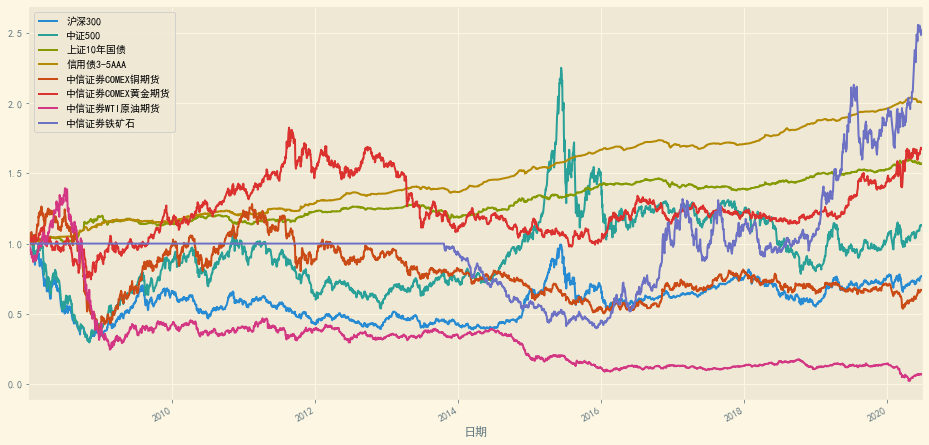

In [17]:
cumReturns.plot(figsize=(16, 8))

# 风险平价 （普通权重）

**资产明细**
- 沪深300指数
- 中证500指数
- 三年期3A信用债全价指数
- 十年期国债全价指数(自制)
- COMEX铜
- COMEX黄金
- NYMEX原油
- 铁矿石期货

回溯时间：2008年初-至今

买卖单笔手续费：千1

## 程序运行

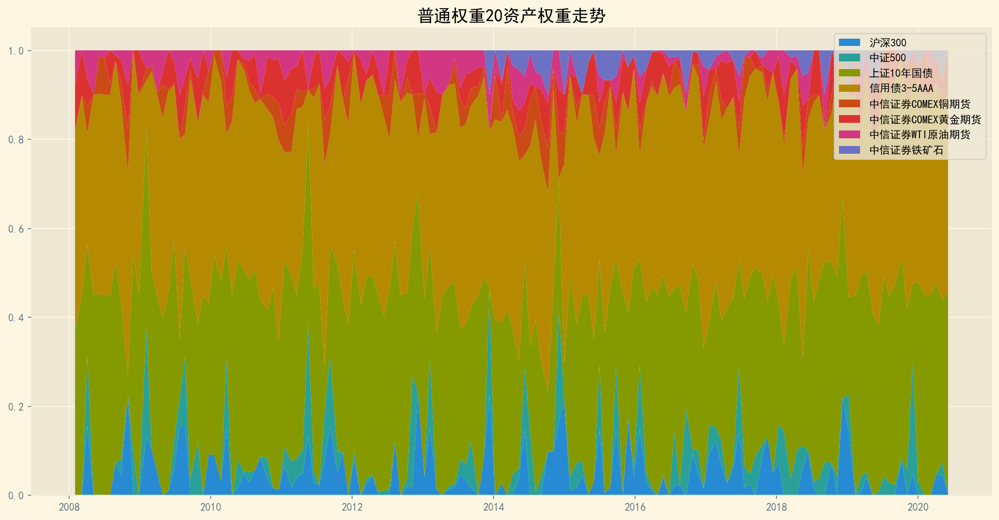

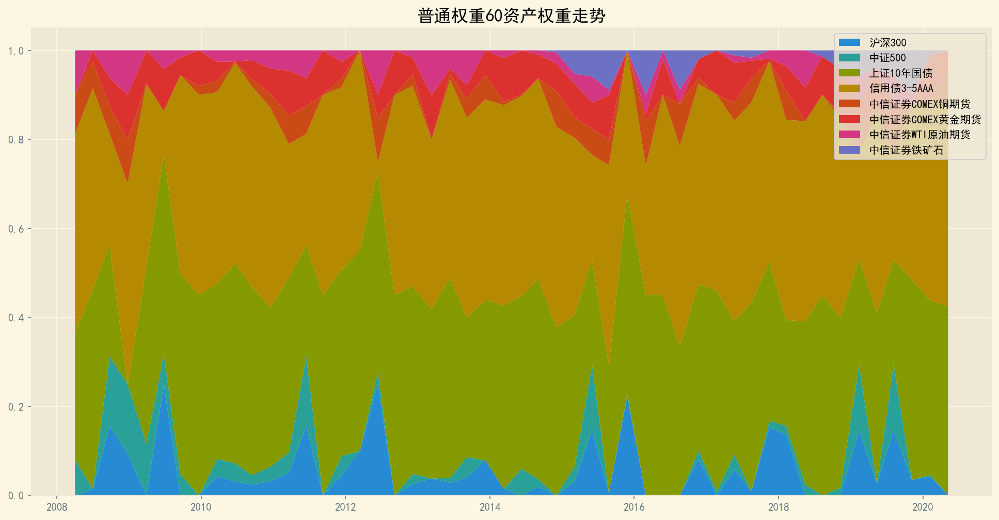

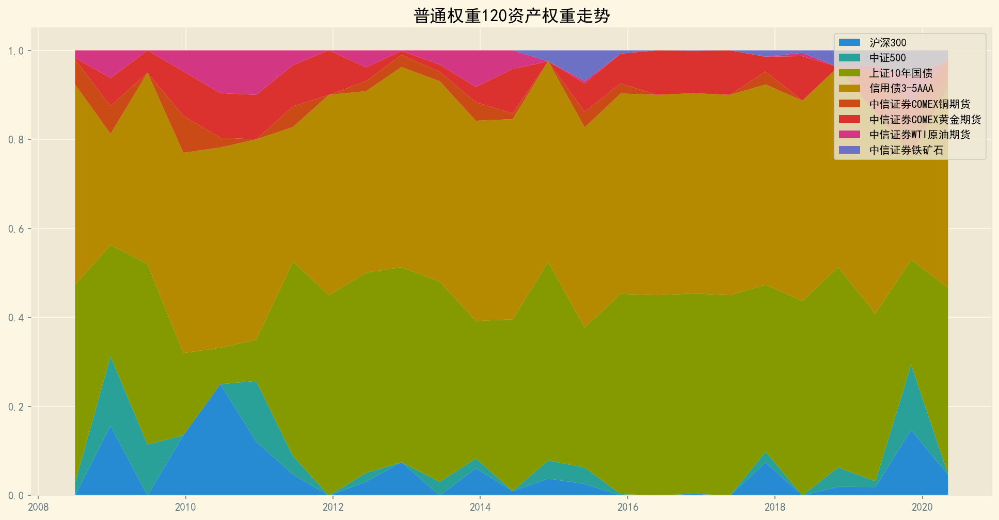

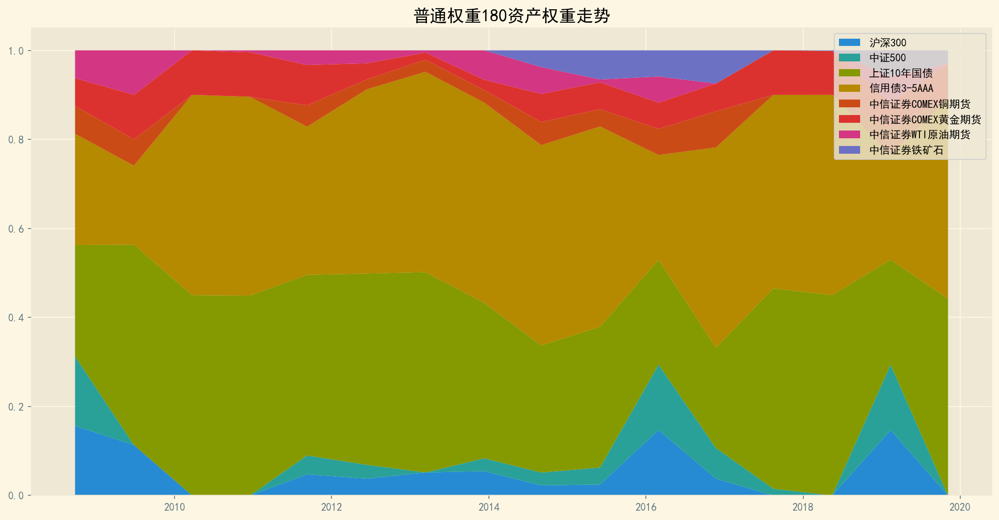

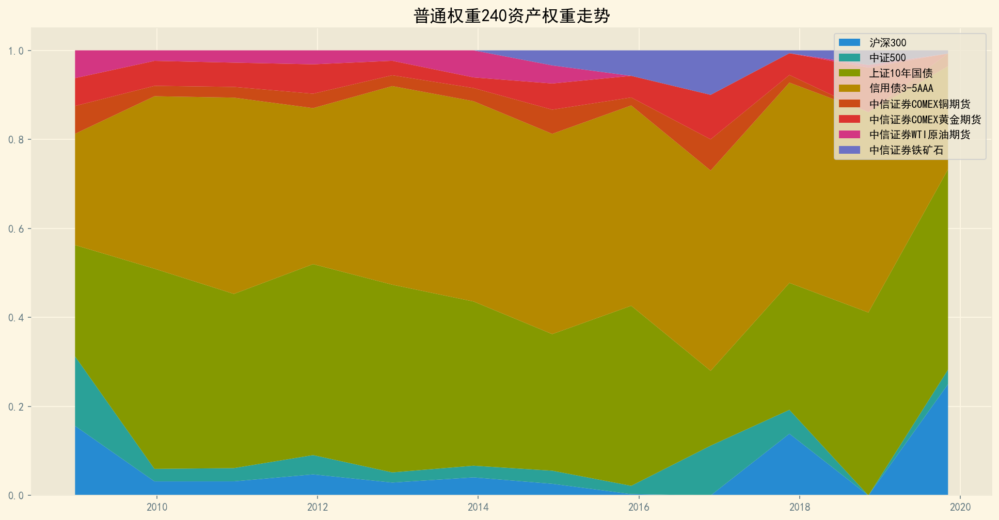

In [18]:
# 运行
timeWindow = [20, 60, 120, 180, 240]           # 调仓周期

NetValueDF = pd.DataFrame(index=Returns.index)
DailyPnlDF = pd.DataFrame(index=Returns.index) 
DrawDownDF = pd.DataFrame(index=Returns.index)

for dtime in timeWindow:
    tradeDF, weightDF = AlgoLoop.AlgoTrade(Assets, Returns, cumReturns, Turnovers, mode='plain', dt=dtime)
    
    StatisticFunc.WeightPlot(tradeDF, weightDF, '普通权重' + str(dtime))
    
    NetValueDF[str(dtime)+'组合净值'] = tradeDF['投资组合净值'] / 10000  
    DailyPnlDF[str(dtime)+'组合日收益率'] = tradeDF['投资组合净值'] / tradeDF['投资组合净值'].shift(1) - 1.0
    DrawDownDF[str(dtime)+'最大回撤'] = tradeDF['最大回撤']   


## 回测表现汇总

In [19]:
# 汇总
summaryDF = pd.DataFrame(index=['每月调仓', '每季度调仓', '每半年调仓', 
                                '每三季度调仓', '每年调仓'])

summaryDF["年平均收益率"] = DailyPnlDF.mean(axis=0).values * 250
summaryDF["年平均标准差"] = DailyPnlDF.std(axis=0).values * np.sqrt(250)
summaryDF["无基准夏普比率"] = summaryDF["年平均收益率"] / summaryDF["年平均标准差"]
summaryDF["最大回撤"] = DrawDownDF.min(axis=0).values
summaryDF

,年平均收益率,年平均标准差,无基准夏普比率,最大回撤
每月调仓,0.041448,0.054583,0.759354,-0.098913
每季度调仓,0.040510,0.062029,0.653085,-0.182495
每半年调仓,0.061797,0.054151,1.141210,-0.086010
每三季度调仓,0.066229,0.057544,1.150923,-0.132513
每年调仓,0.070132,0.059053,1.187615,-0.104662


## 各投资组合净值曲线

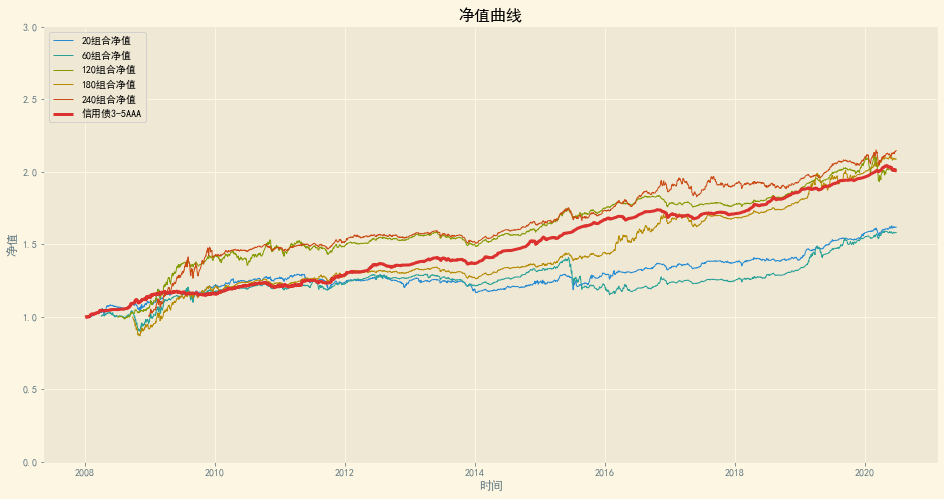

In [20]:
fig = plt.figure(figsize=(16, 8))

for col in NetValueDF.columns:
    plt.plot(NetValueDF.index, NetValueDF[col], lw=1.0, label=col)

plt.plot(cumReturns.index, cumReturns['信用债3-5AAA'], lw=3.0, label='信用债3-5AAA')

plt.xlabel('时间')
plt.ylabel('净值')
plt.ylim(0.0, 3.0)
plt.legend(loc='upper left')
plt.title('净值曲线')
plt.show()

## 年间收益率分布

In [19]:
yearReturns = StatisticFunc.annualReturns(NetValueDF)

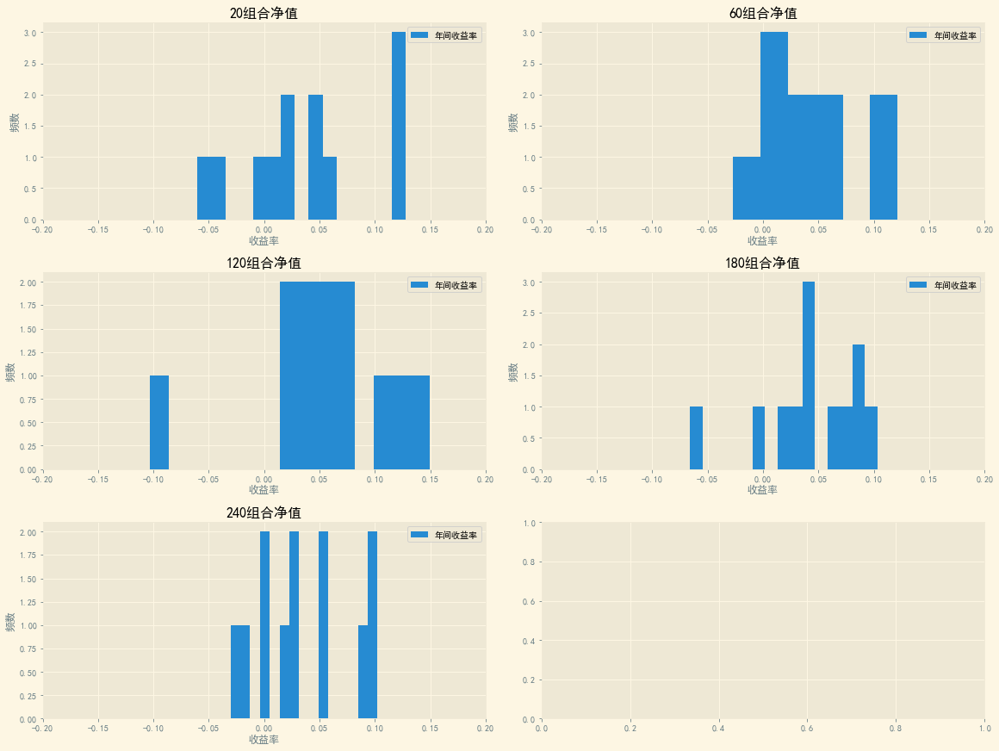

In [20]:
StatisticFunc.ReturnDist(yearReturns, 2)

## 月间收益率分布

In [21]:
monthlyReturns = StatisticFunc.monthlyReturns(NetValueDF)

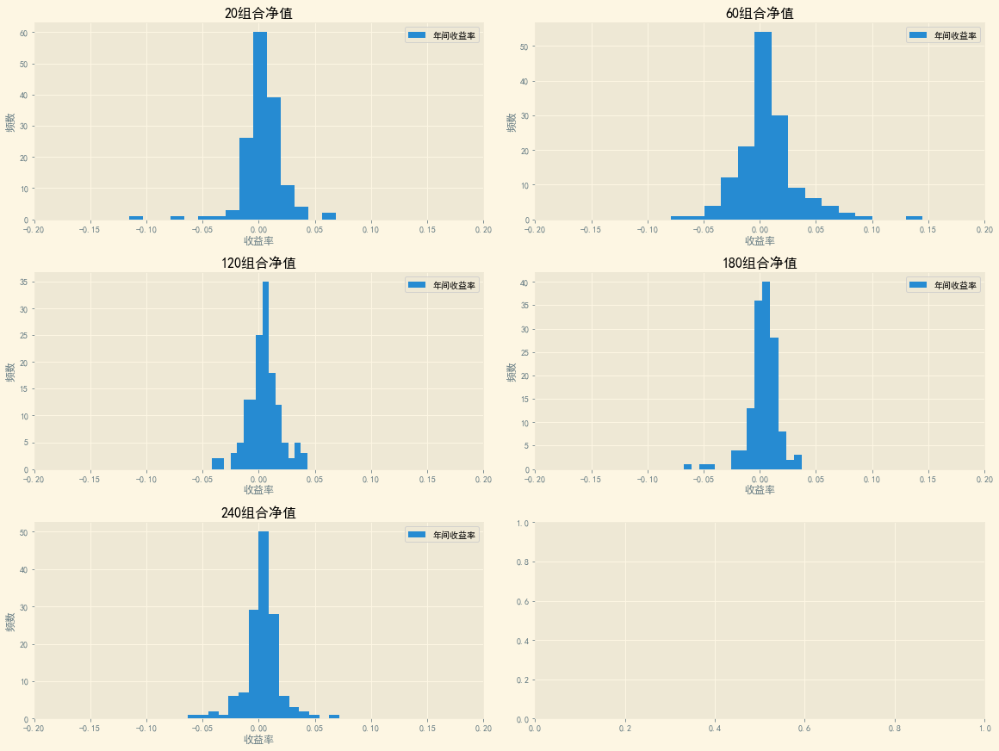

In [22]:
StatisticFunc.ReturnDist(monthlyReturns, 2)

# 风险平价 + 杠杆策略（普通权重）

## 杠杆调整后的债券净值

In [21]:
lever = 2.0                                 # 杠杆
leverReturns = Returns.copy()               # 创建副本 
leverCumReturns = cumReturns.copy()   

# 更新杠杆调整后的债券净值
leverReturns.loc[:, ['上证10年国债', '信用债3-5AAA']] = Returns.loc[:, ['上证10年国债', '信用债3-5AAA']] * (1.0 + lever) - Rates.values * lever / (365.0 * 100)

# 更新累计净值
leverCumReturns = (1.0 + leverReturns)
leverCumReturns = leverCumReturns.fillna(1.0)                    # 填充空值
leverCumReturns = leverCumReturns.cumprod()                      # 计算各资产累计收益率

In [22]:
leverReturns

,沪深300,中证500,上证10年国债,信用债3-5AAA,中信证券COMEX铜期货,中信证券COMEX黄金期货,中信证券WTI原油期货,中信证券铁矿石
日期,,,,,,,,
2008-01-03,0.006858,0.020846,0.00291366,-0.00496922,0.037320,0.007522,-0.007431,NaN
2008-01-04,0.011364,0.002348,0.00708695,0.00101937,-0.009513,-0.003857,-0.012751,NaN
2008-01-07,0.013302,0.019983,0.00249391,0.000364268,-0.006374,-0.005423,-0.029923,NaN
2008-01-08,-0.005136,-0.027535,-0.00194137,-0.00423672,0.051530,0.022578,0.014378,NaN
2008-01-09,0.015503,0.029983,0.000214022,-0.00138699,-0.005478,0.000652,-0.008178,NaN
...,...,...,...,...,...,...,...,...
2020-06-19,0.013432,0.009198,-0.0039725,-0.00024998,0.006846,0.012794,0.020118,0.004563
2020-06-22,0.000814,-0.000539,-0.00676313,-0.00322565,0.012442,0.006962,0.021904,-0.014276
2020-06-23,0.004814,0.003512,0.000476333,-0.00583903,-0.000490,0.006070,-0.011552,-0.005267


## 程序运行

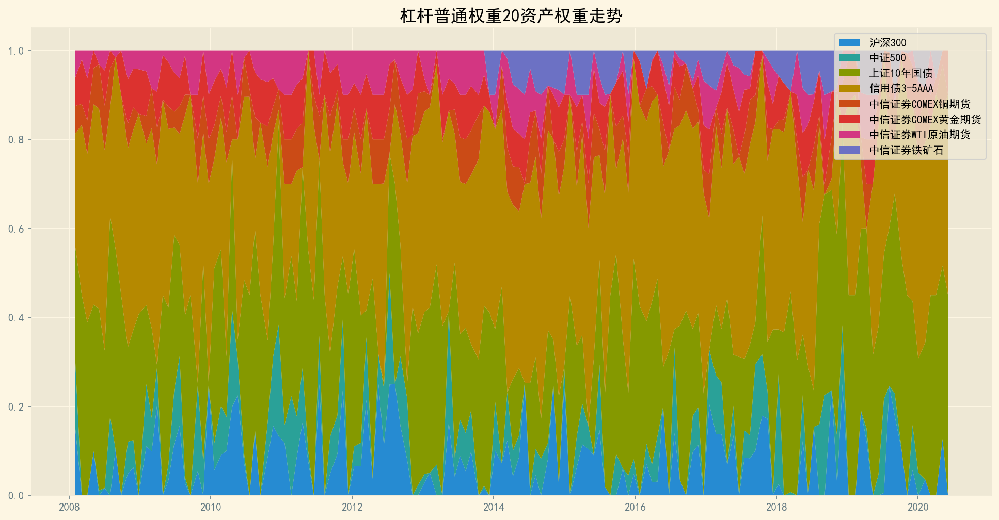

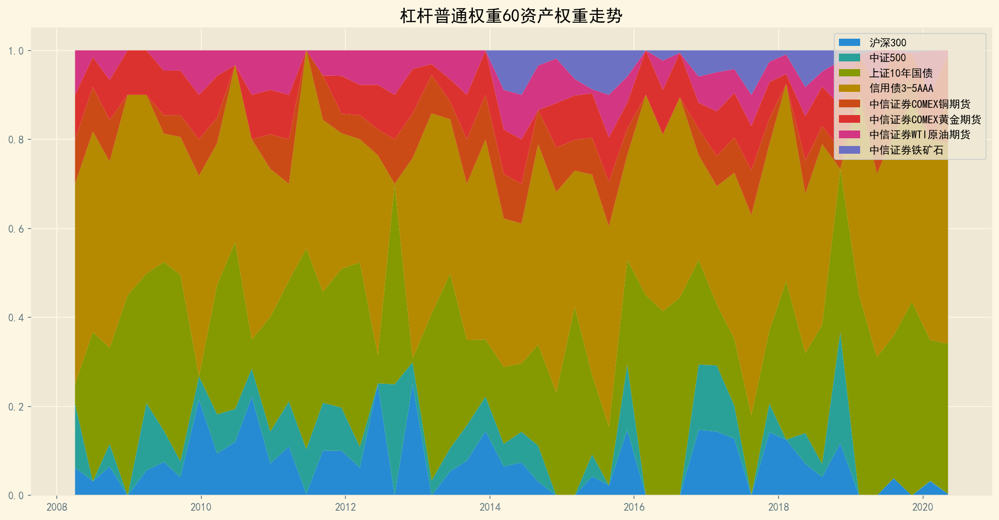

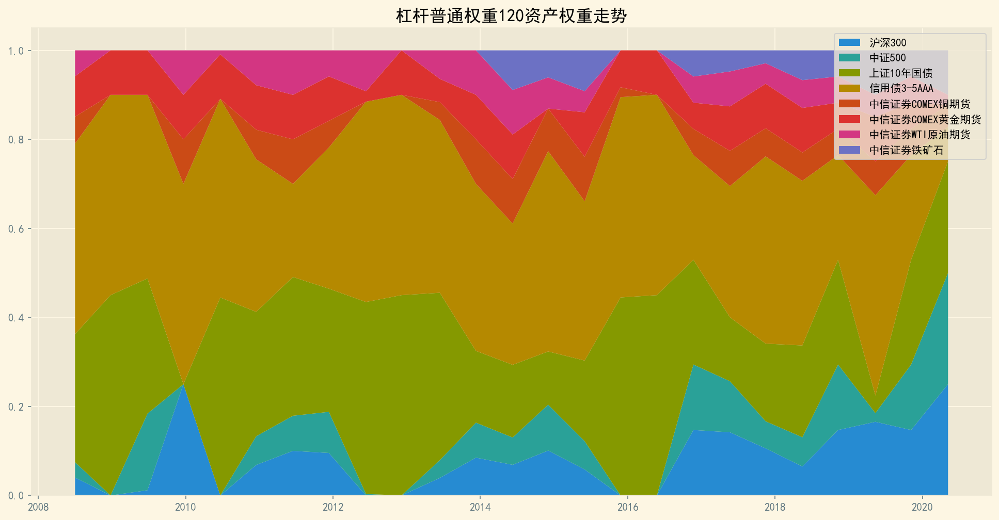

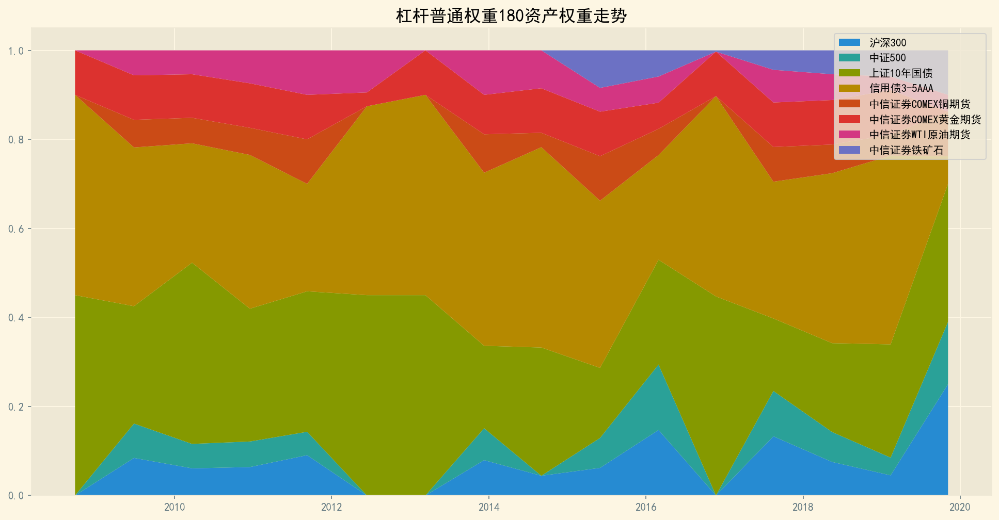

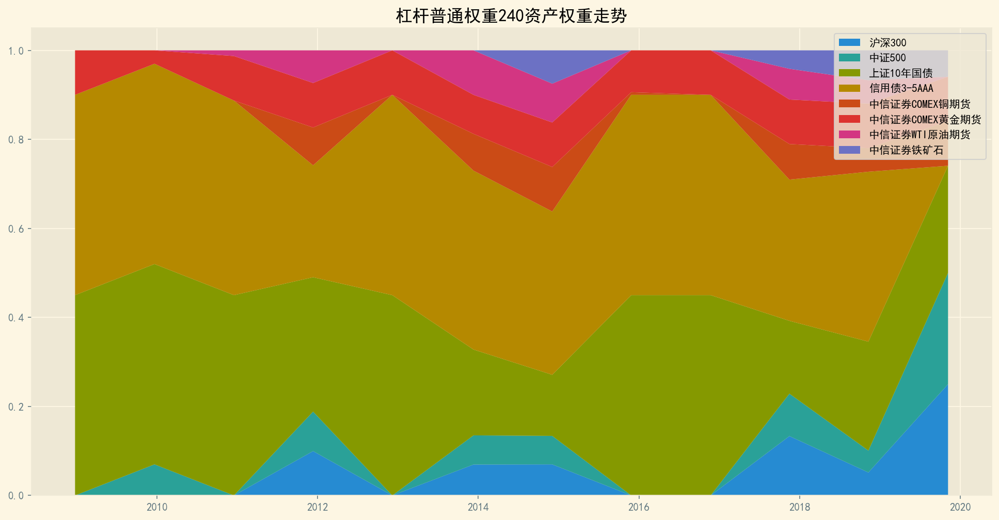

In [23]:
# 运行
timeWindow = [20, 60, 120, 180, 240]           # 调仓周期

leverNetValueDF = pd.DataFrame(index=Returns.index)
leverDailyPnlDF = pd.DataFrame(index=Returns.index) 
leverDrawDownDF = pd.DataFrame(index=Returns.index)

for dtime in timeWindow:
    tradeDF, weightDF = AlgoLoop.AlgoTrade(Assets, leverReturns, leverCumReturns, Turnovers, mode='plain', dt=dtime)
    StatisticFunc.WeightPlot(tradeDF, weightDF, '杠杆普通权重'+str(dtime))
    
    leverNetValueDF[str(dtime)+'组合净值'] = tradeDF['投资组合净值'] / 10000
    leverDailyPnlDF[str(dtime)+'组合日收益率'] = tradeDF['投资组合净值'] / tradeDF['投资组合净值'].shift(1) - 1.0
    leverDrawDownDF[str(dtime)+'最大回撤'] = tradeDF['最大回撤']   


## 回测表现汇总

In [24]:
# 汇总
leverSummaryDF = pd.DataFrame(index=['每月调仓', '每季度调仓', '每半年调仓', 
                                '每三季度调仓', '每年调仓'])

leverSummaryDF["年平均收益率"] = leverDailyPnlDF.mean(axis=0).values * 250
leverSummaryDF["年平均标准差"] = leverDailyPnlDF.std(axis=0).values * np.sqrt(250)
leverSummaryDF["无基准夏普比率"] = leverSummaryDF["年平均收益率"] / leverSummaryDF["年平均标准差"]
leverSummaryDF["最大回撤"] = leverDrawDownDF.min(axis=0).values
leverSummaryDF

,年平均收益率,年平均标准差,无基准夏普比率,最大回撤
每月调仓,0.057475,0.077527,0.741363,-0.243521
每季度调仓,0.037478,0.075161,0.498629,-0.142091
每半年调仓,0.069944,0.074524,0.938548,-0.147563
每三季度调仓,0.069611,0.073580,0.946064,-0.177812
每年调仓,0.049968,0.070353,0.710248,-0.175993


## 各投资组合净值曲线

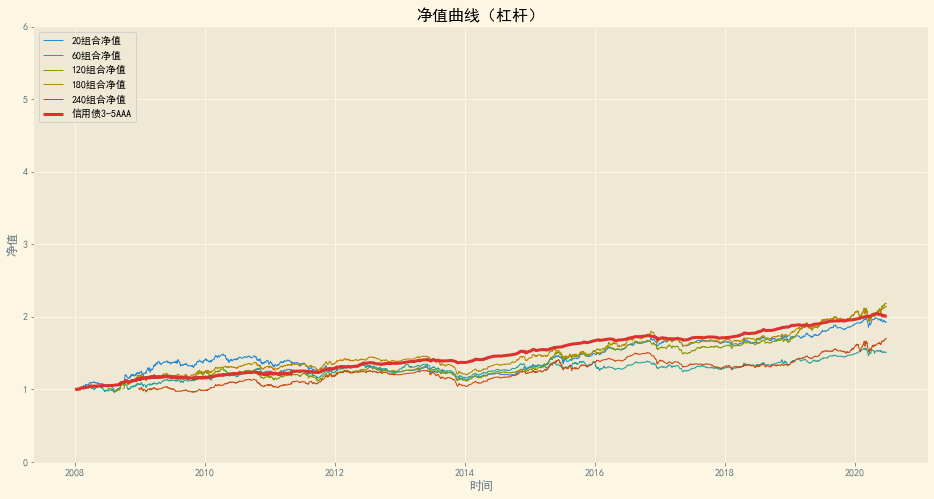

In [25]:
fig = plt.figure(figsize=(16, 8))

for col in leverNetValueDF.columns:
    plt.plot(leverNetValueDF.index, leverNetValueDF[col], lw=1.0, label=col)

# plt.plot(cumReturns.index, cumReturns['中证500'], lw=1.5, label='中证500')
plt.plot(cumReturns.index, cumReturns['信用债3-5AAA'], lw=3.0, label='信用债3-5AAA')

plt.xlabel('时间')
plt.ylabel('净值')
plt.ylim(0.0, 6.0)
plt.legend(loc='upper left')
plt.title('净值曲线（杠杆）')
plt.show()

## 年间收益率分布

In [ ]:
yearReturns = StatisticFunc.annualReturns(NetValueDF)

In [ ]:
StatisticFunc.ReturnDist(yearReturns, 2)

## 月间收益率分布

In [ ]:
monthlyReturns = StatisticFunc.monthlyReturns(NetValueDF)

In [ ]:
StatisticFunc.ReturnDist(monthlyReturns, 2)

# 风险平价 + 杠杆 + 因子策略（普通权重）

## 动量因子（横向比较）

### 程序运行

In [35]:
# 运行
timeWindow = [20, 60, 120, 180, 240]        # 调仓周期
ups = [0.50, 1.00]        # 上调幅度

multiIDX = pd.MultiIndex.from_product([timeWindow, ups], names=['交易周期', '上调幅度'])
leverNetValueDF_momentumX = pd.DataFrame(index=Returns.index, columns=multiIDX)
leverDailyPnlDF_momentumX = pd.DataFrame(index=Returns.index, columns=multiIDX) 
leverDrawDownDF_momentumX = pd.DataFrame(index=Returns.index, columns=multiIDX)

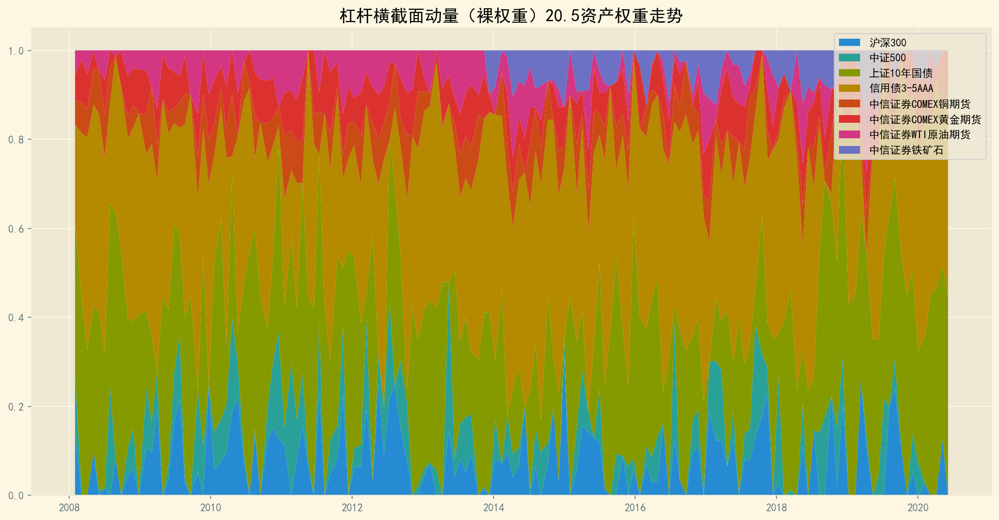

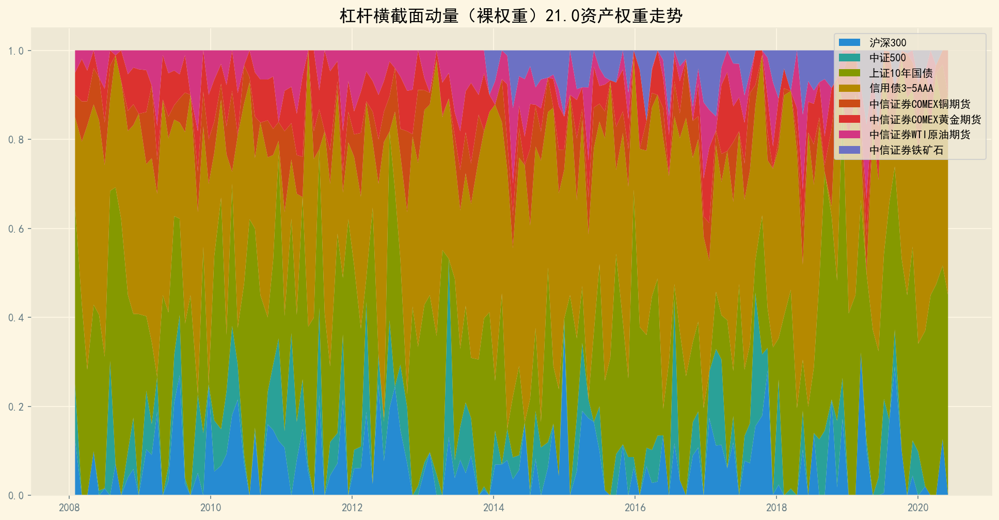

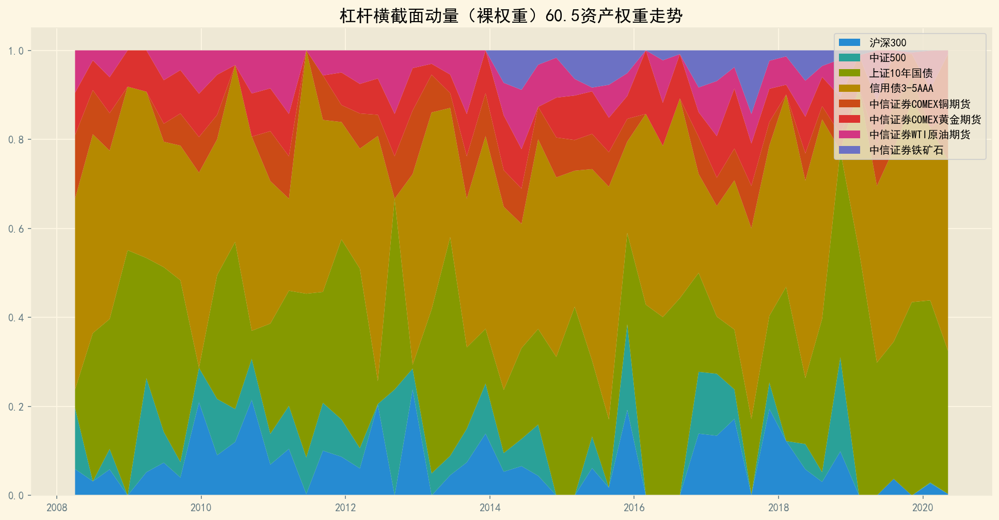

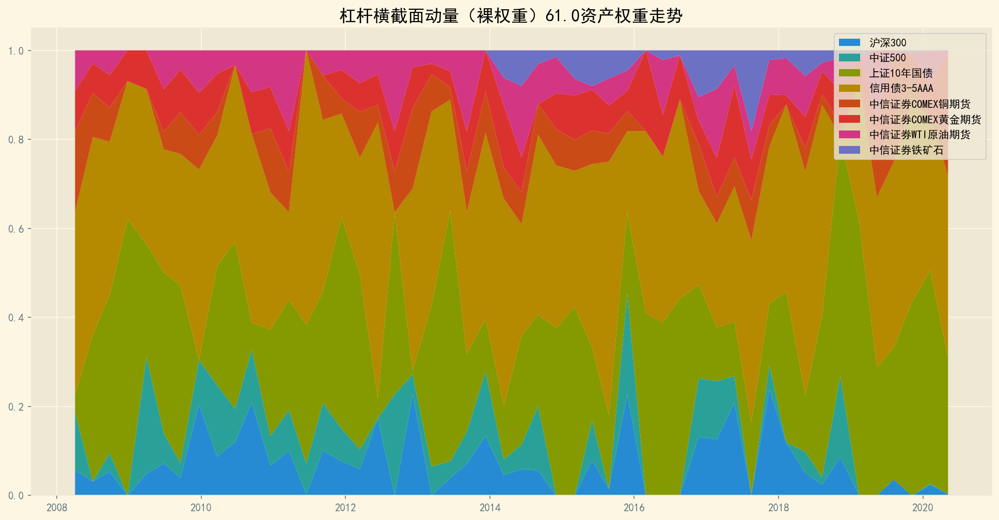

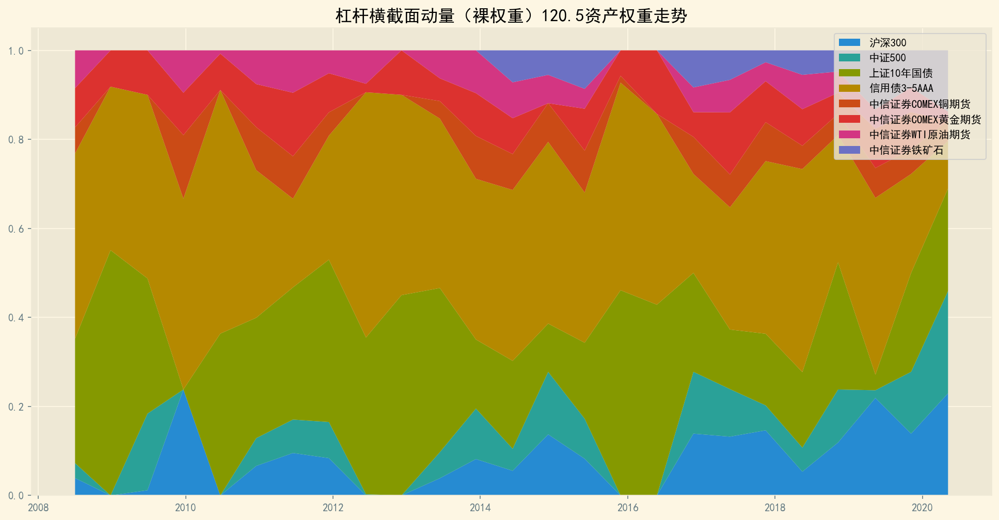

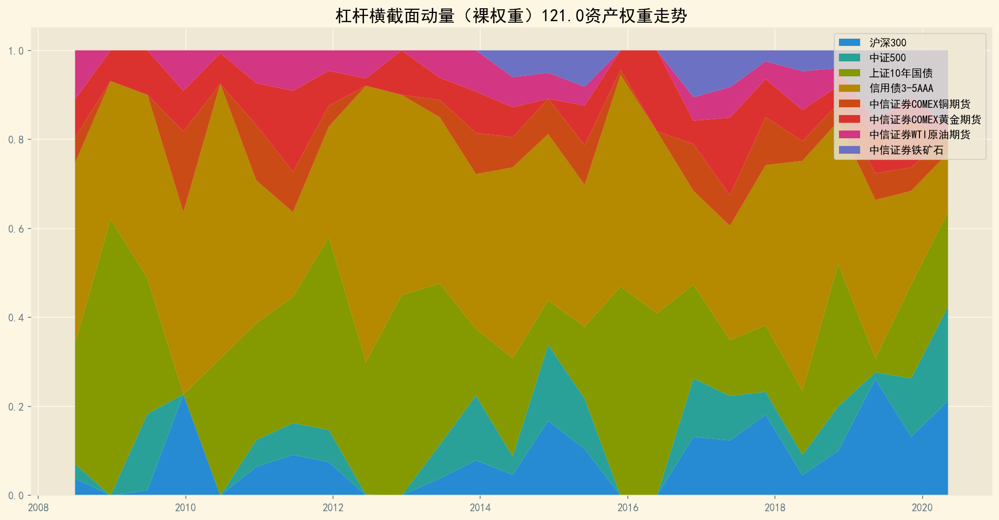

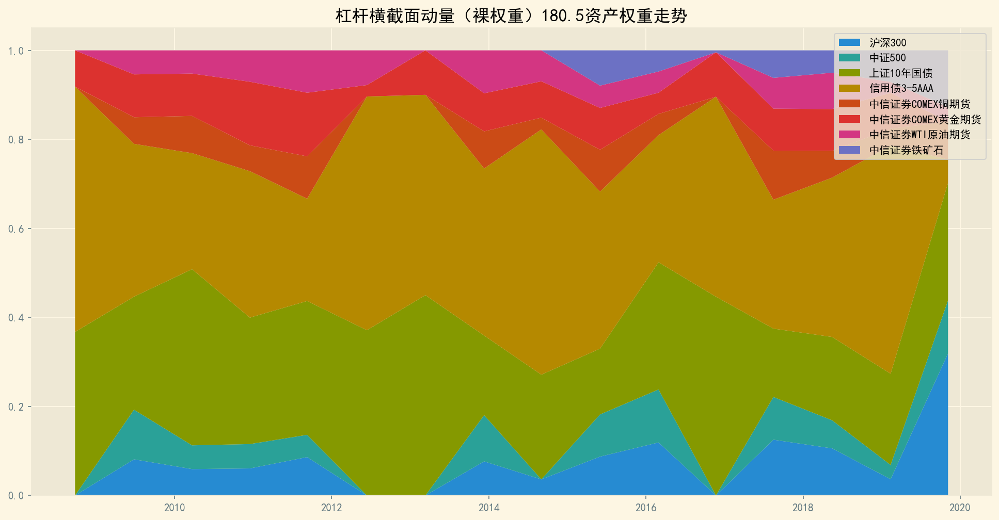

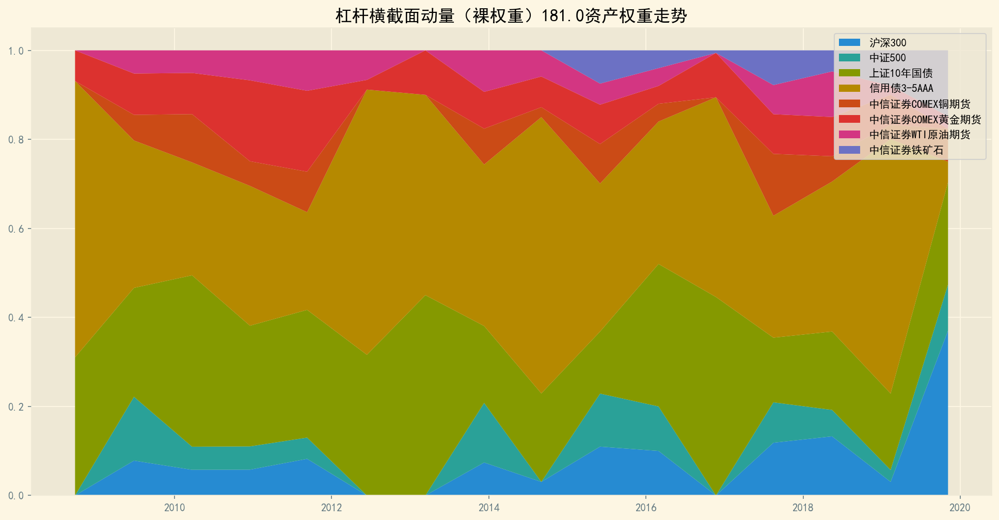

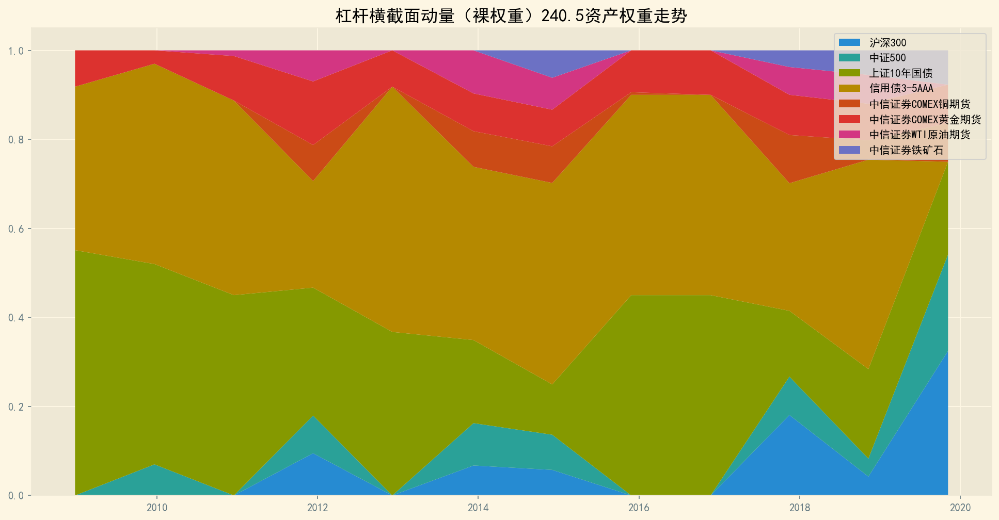

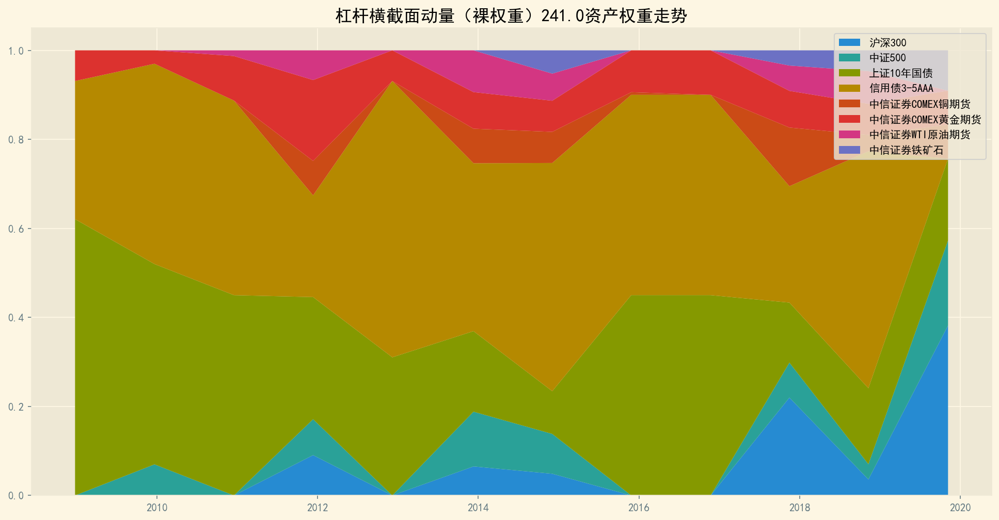

In [36]:
thrds = {'Equity':0.50, 'FixedIncome':0.90, 'Commodity':0.30}
factors = {'momentumX':True, 'momentumT':False, 
           'reverseX':False, 'reverseT':False, 
           'turnover':False,  
           'copperGold':False, 'copperGas':False}

for t in timeWindow:
    for u in ups:
        tradeDF, weightDF = AlgoLoop.AlgoTrade(Assets, leverReturns, leverCumReturns, Turnovers, 
                                               mode='plain', dt=t, up=u, thresholds=thrds,
                                               factorDict=factors)
        StatisticFunc.WeightPlot(tradeDF, weightDF, '杠杆横截面动量（裸权重）'+str(t+u))

        leverNetValueDF_momentumX.loc[:, (t, u)] = tradeDF['投资组合净值'] / 10000
        leverDailyPnlDF_momentumX.loc[:, (t, u)] = tradeDF['投资组合净值'] / tradeDF['投资组合净值'].shift(1) - 1.0
        leverDrawDownDF_momentumX.loc[:, (t, u)] = tradeDF['最大回撤']                      

### 回测表现汇总

In [37]:
# 汇总
leverSummaryDF_momentumX = pd.DataFrame(index=multiIDX)

leverSummaryDF_momentumX["年平均收益率"] = leverDailyPnlDF_momentumX.mean(axis=0).values * 250
leverSummaryDF_momentumX["年平均标准差"] = leverDailyPnlDF_momentumX.std(axis=0).values * np.sqrt(250)
leverSummaryDF_momentumX["无基准夏普比率"] = leverSummaryDF_momentumX["年平均收益率"] / leverSummaryDF_momentumX["年平均标准差"]
leverSummaryDF_momentumX["最大回撤"] = leverDrawDownDF_momentumX.min(axis=0).values

leverSummaryDF_momentumX

年平均收益率    年平均标准差   无基准夏普比率      最大回撤
交易周期 上调幅度                                        
20   0.5   0.061595  0.079358  0.776171 -0.240307
     1.0   0.064518  0.082201  0.784881 -0.239519
60   0.5   0.035521  0.076811  0.462449 -0.157215
     1.0   0.033740  0.079714  0.423260 -0.174449
120  0.5   0.071107  0.076605  0.928239 -0.144934
     1.0   0.071705  0.079787  0.898706 -0.142939
180  0.5   0.067527  0.075459  0.894889 -0.179015
     1.0   0.065680  0.078389  0.837881 -0.180762
240  0.5   0.050724  0.070839  0.716039 -0.167099
     1.0   0.051071  0.072007  0.709252 -0.162413

### 各投资组合净值曲线

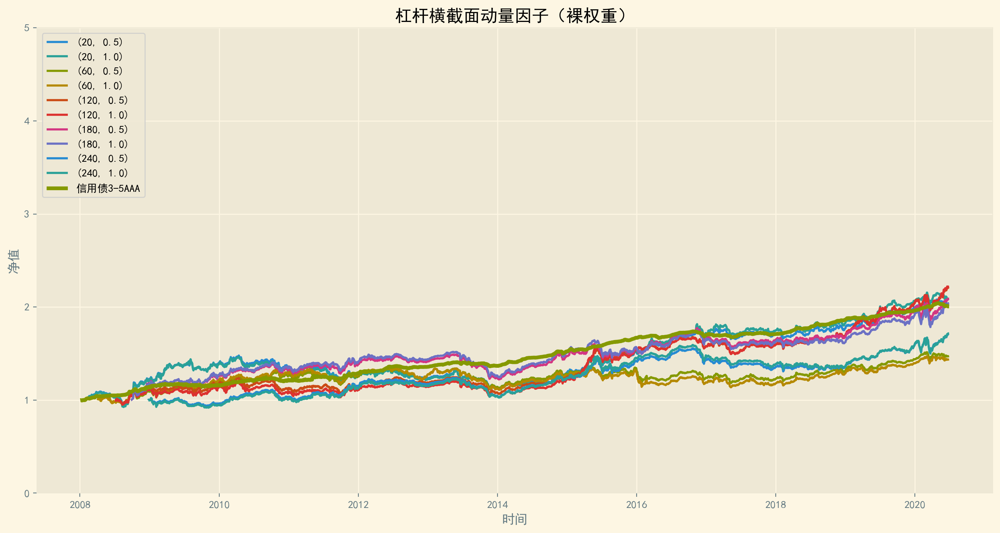

In [38]:
fig = plt.figure(figsize=(16, 8), dpi=200)

for col in leverNetValueDF_momentumX.columns:
    plt.plot(leverNetValueDF_momentumX.index, leverNetValueDF_momentumX[col], label=col)
    
plt.plot(cumReturns.index, cumReturns['信用债3-5AAA'], lw=3.5, label='信用债3-5AAA')

plt.xlabel('时间')
plt.ylabel('净值')
plt.ylim(0.0, 5.0)
plt.legend(loc='upper left')
plt.title('杠杆横截面动量因子（裸权重）')
plt.show()

## 动量因子（时序比较）

### 程序运行

In [70]:
# 运行
timeWindow = [20, 60, 120, 180, 240]        # 调仓周期
ups = [0.50, 1.00]                          # 上调幅度

multiIDX = pd.MultiIndex.from_product([timeWindow, ups], names=['交易周期', '上调幅度'])
leverNetValueDF_momentumT = pd.DataFrame(index=Returns.index, columns=multiIDX)
leverDailyPnlDF_momentumT = pd.DataFrame(index=Returns.index, columns=multiIDX) 
leverDrawDownDF_momentumT = pd.DataFrame(index=Returns.index, columns=multiIDX)

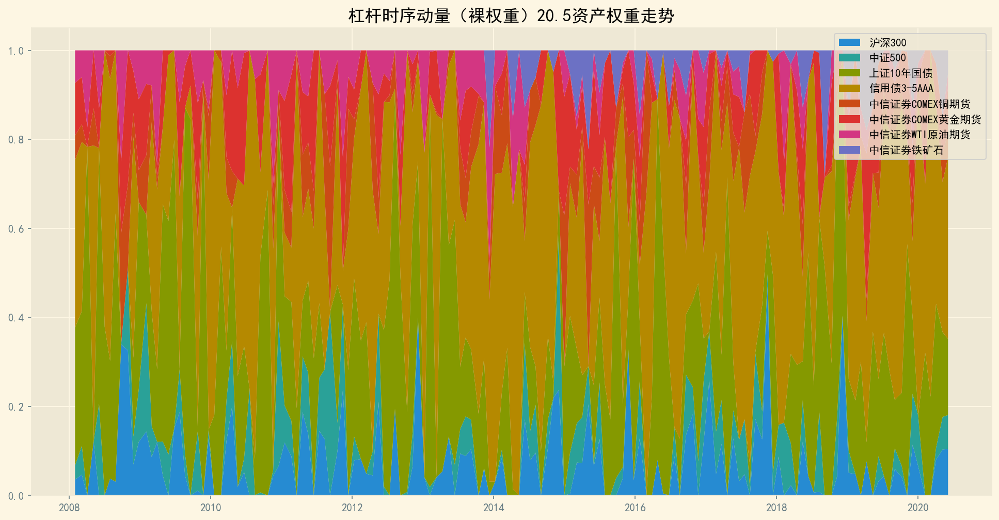

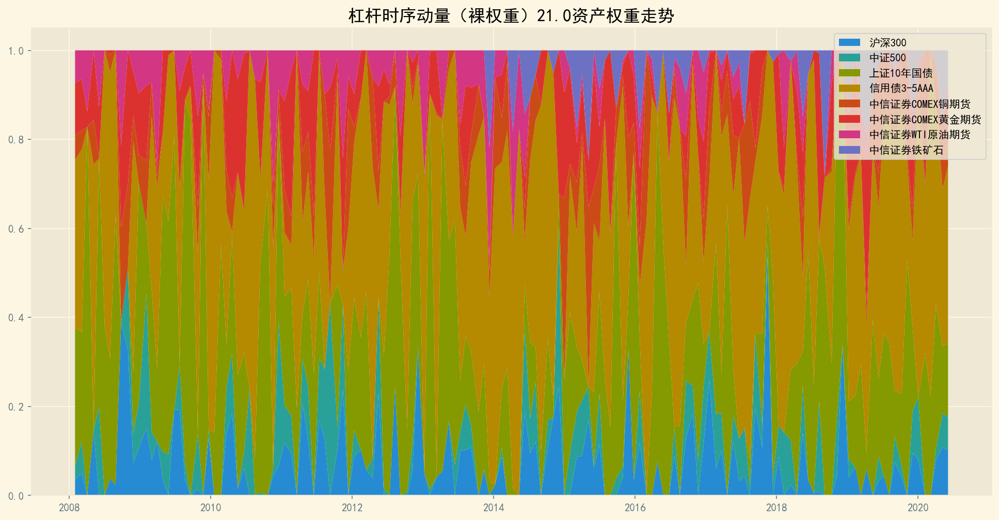

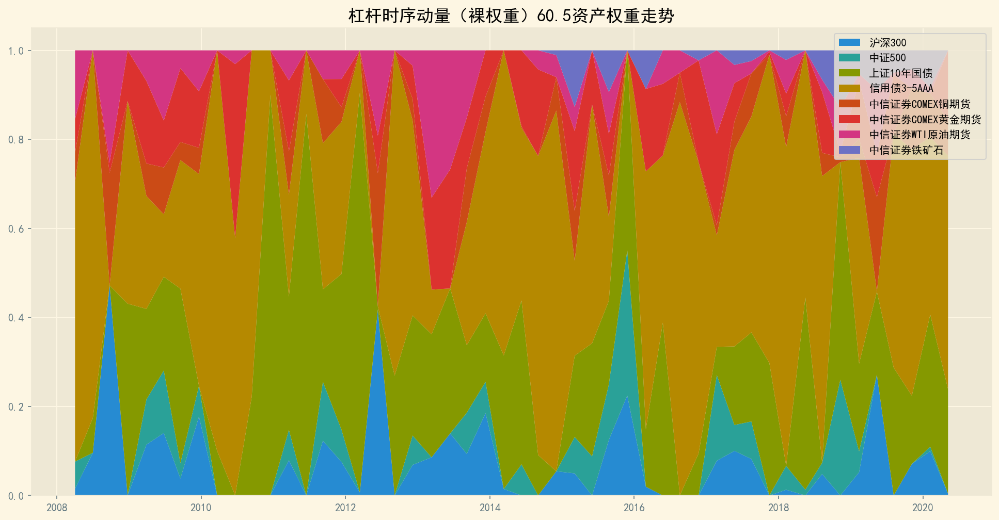

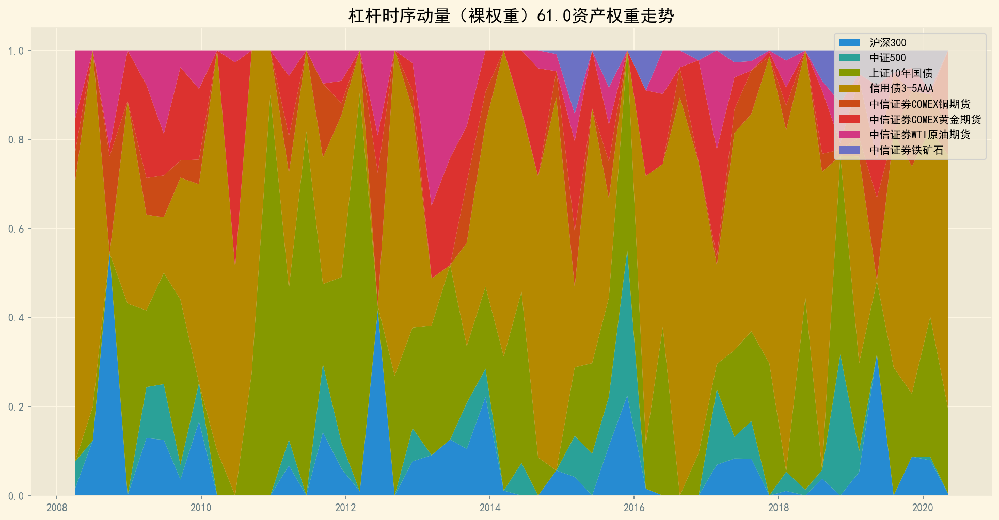

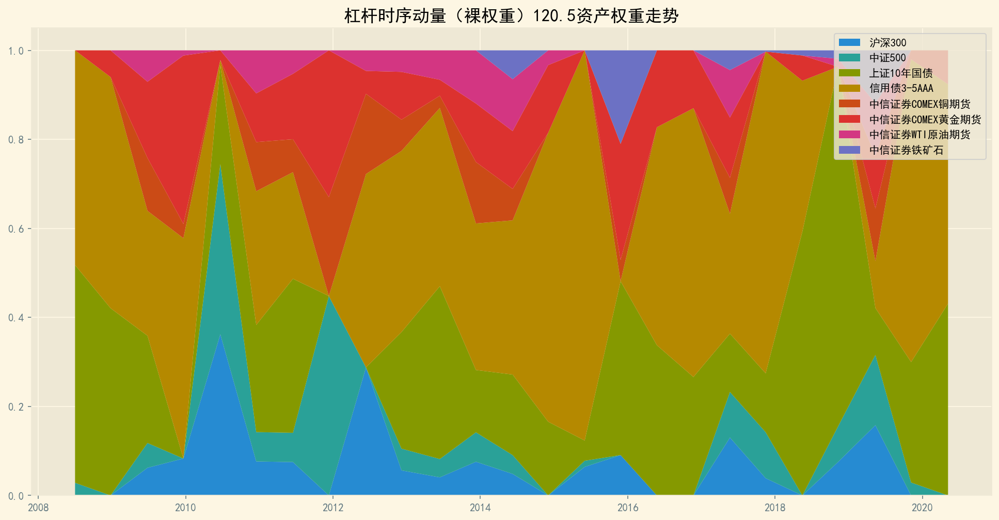

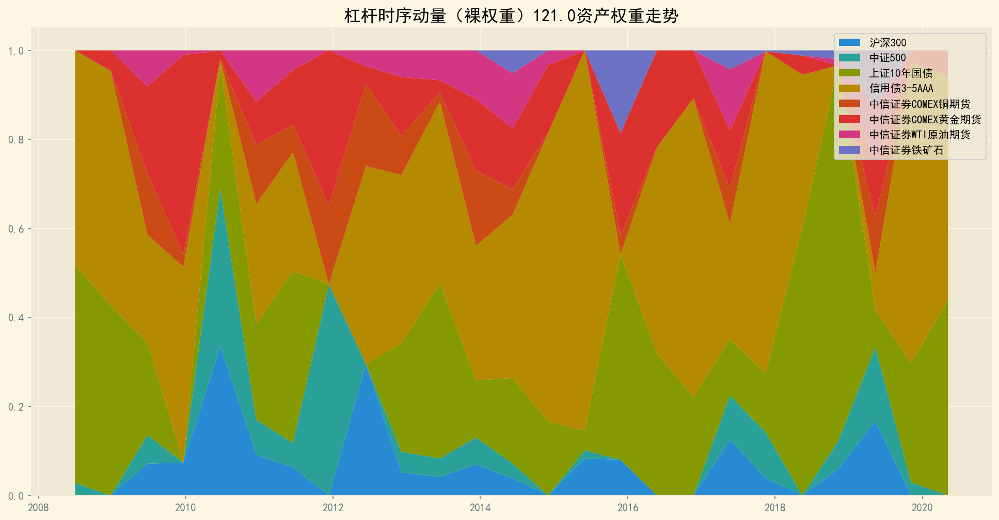

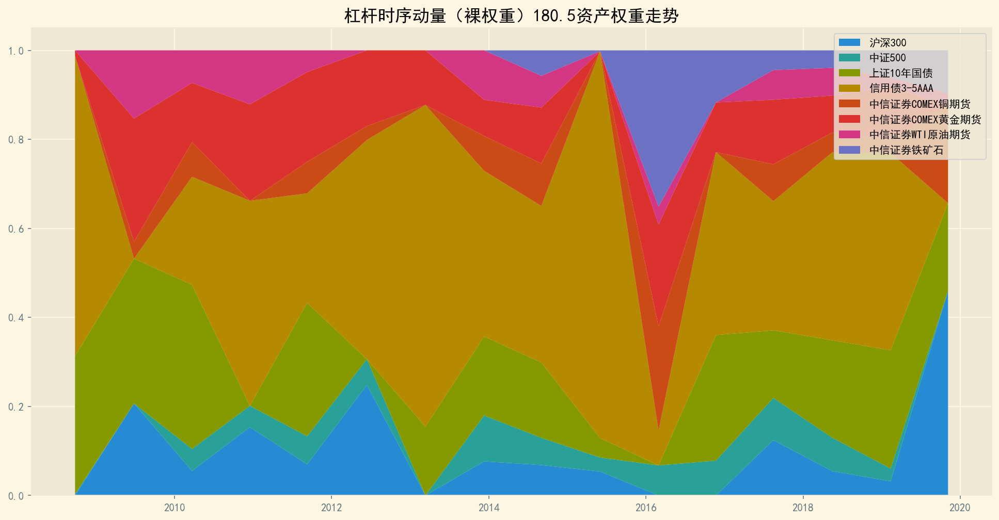

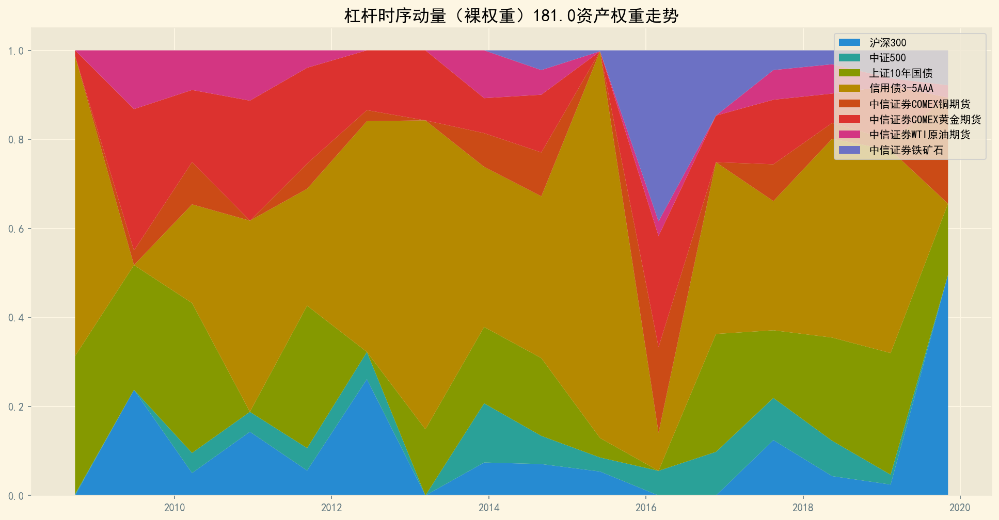

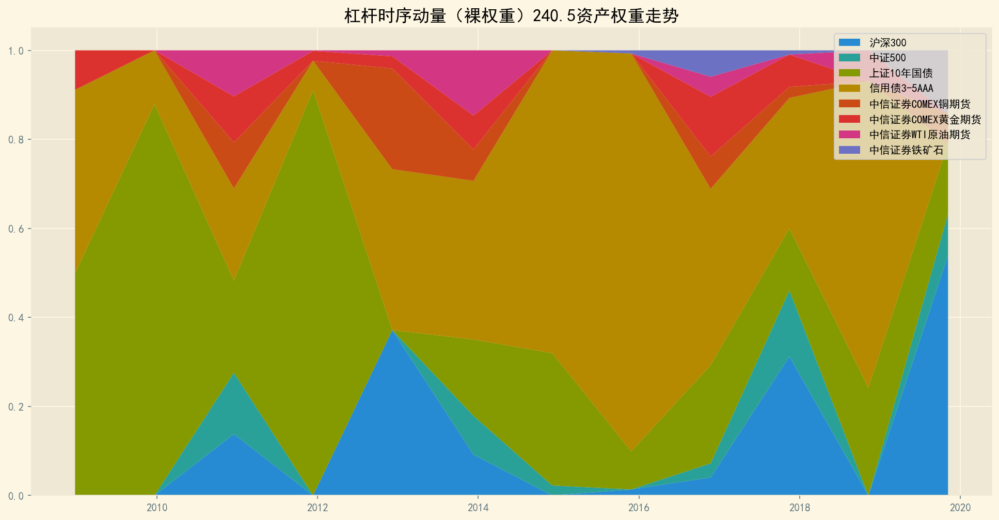

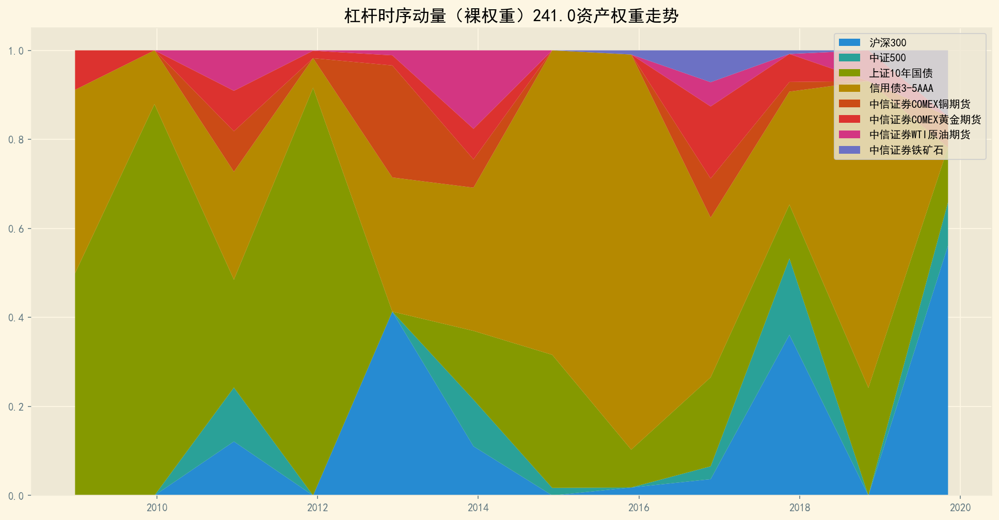

In [71]:
thrds = {'Equity':0.50, 'FixedIncome':0.90, 'Commodity':0.30}
factors = {'momentumX':False, 'momentumT':True, 
           'reverseX':False, 'reverseT':False, 
           'turnover':False,  
           'copperGold':False, 'copperGas':False}

for t in timeWindow:
    for u in ups:
        tradeDF, weightDF = AlgoLoop.AlgoTrade(Assets, leverReturns, leverCumReturns, Turnovers, 
                                               mode='plain', dt=t, up=u, thresholds=thrds, 
                                               factorDict=factors)
        StatisticFunc.WeightPlot(tradeDF, weightDF, '杠杆时序动量（裸权重）'+str(t+u))

        leverNetValueDF_momentumT.loc[:, (t, u)] = tradeDF['投资组合净值'] / 10000  
        leverDailyPnlDF_momentumT.loc[:, (t, u)] = tradeDF['投资组合净值'] / tradeDF['投资组合净值'].shift(1) - 1.0
        leverDrawDownDF_momentumT.loc[:, (t, u)] = tradeDF['最大回撤']                      

### 回测表现汇总

In [72]:
# 汇总
leverSummaryDF_momentumT = pd.DataFrame(index=multiIDX)

leverSummaryDF_momentumT["年平均收益率"] = leverDailyPnlDF_momentumT.mean(axis=0).values * 250
leverSummaryDF_momentumT["年平均标准差"] = leverDailyPnlDF_momentumT.std(axis=0).values * np.sqrt(250)
leverSummaryDF_momentumT["无基准夏普比率"] = leverSummaryDF_momentumT["年平均收益率"] / leverSummaryDF_momentumT["年平均标准差"]
leverSummaryDF_momentumT["最大回撤"] = leverDrawDownDF_momentumT.min(axis=0).values

leverSummaryDF_momentumT

年平均收益率    年平均标准差   无基准夏普比率      最大回撤
交易周期 上调幅度                                        
20   0.5   0.049350  0.102389  0.481989 -0.327657
     1.0   0.047029  0.100837  0.466388 -0.314145
60   0.5   0.037427  0.109068  0.343148 -0.421185
     1.0   0.038944  0.108051  0.360419 -0.388749
120  0.5   0.104709  0.089757  1.166586 -0.219611
     1.0   0.101485  0.089914  1.128687 -0.226138
180  0.5   0.108131  0.090605  1.193434 -0.148883
     1.0   0.113707  0.093567  1.215246 -0.155127
240  0.5   0.052394  0.080083  0.654247 -0.196150
     1.0   0.051984  0.083406  0.623257 -0.183926

### 各投资组合净值曲线

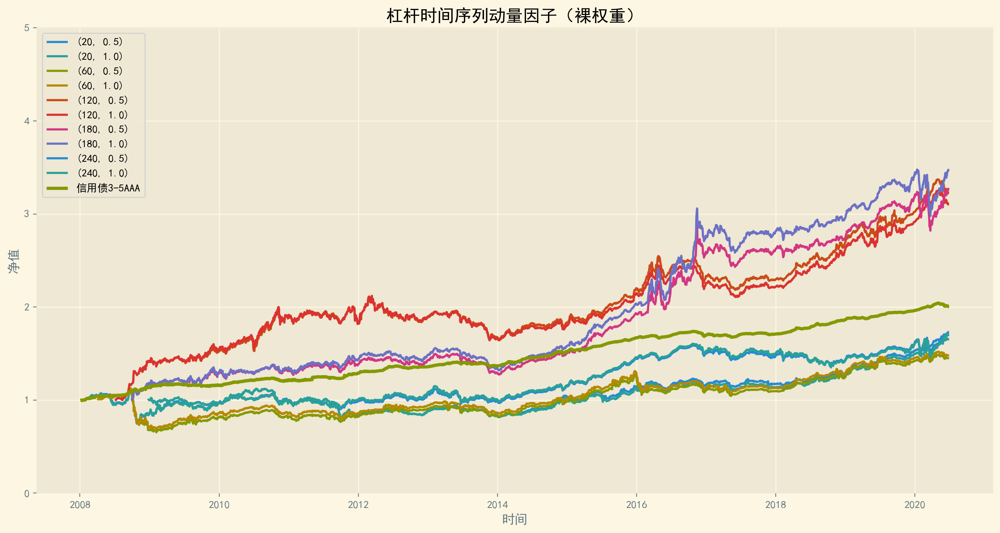

In [73]:
fig = plt.figure(figsize=(16, 8), dpi=200)

for col in leverNetValueDF_momentumT.columns:
    plt.plot(leverNetValueDF_momentumT.index, leverNetValueDF_momentumT[col], label=col)

plt.plot(cumReturns.index, cumReturns['信用债3-5AAA'], lw=3.0, label='信用债3-5AAA')
    
plt.xlabel('时间')
plt.ylabel('净值')
plt.ylim(0.0, 5.0)
plt.legend(loc='upper left')
plt.title('杠杆时间序列动量因子（裸权重）')
plt.show()

## 反转因子（横向比较）

### 程序运行

In [74]:
# 运行
timeWindow = [20, 60, 120, 180, 240]        # 调仓周期
ups = [0.50, 1.00]                          # 上调幅度

multiIDX = pd.MultiIndex.from_product([timeWindow, ups], names=['交易周期', '上调幅度'])
leverNetValueDF_reverseX = pd.DataFrame(index=Returns.index, columns=multiIDX)
leverDailyPnlDF_reverseX = pd.DataFrame(index=Returns.index, columns=multiIDX) 
leverDrawDownDF_reverseX = pd.DataFrame(index=Returns.index, columns=multiIDX)

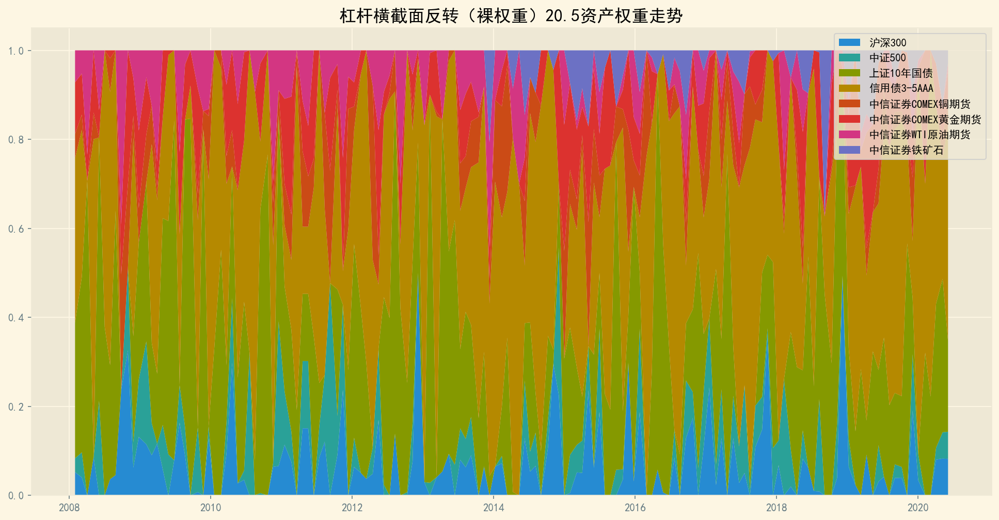

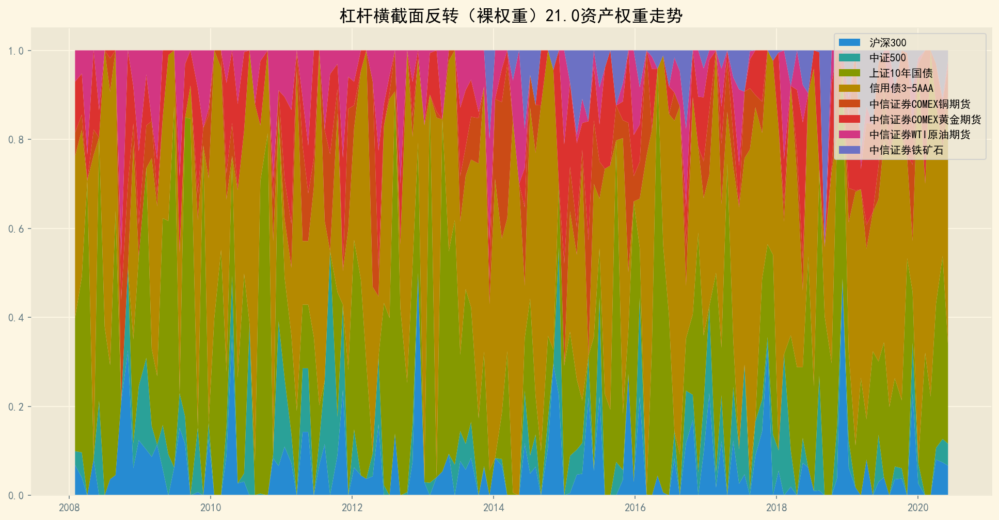

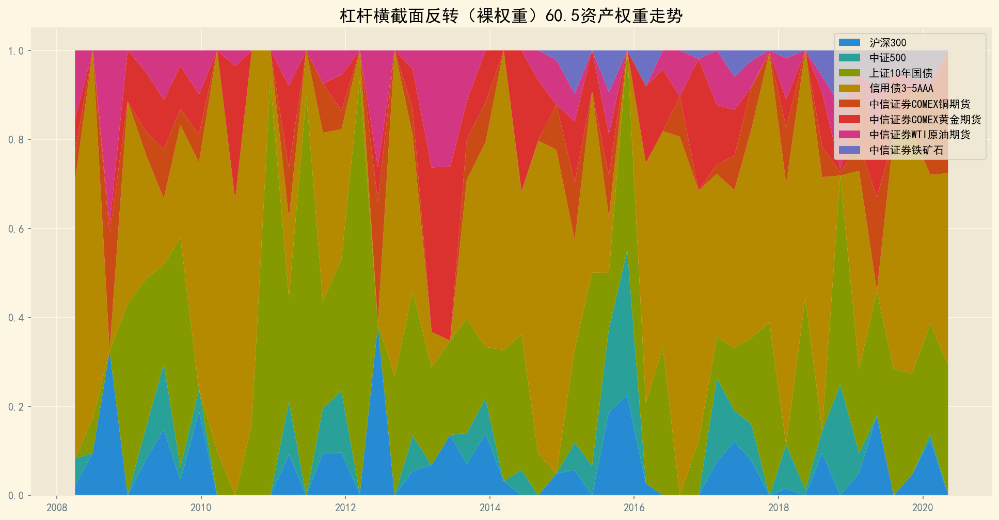

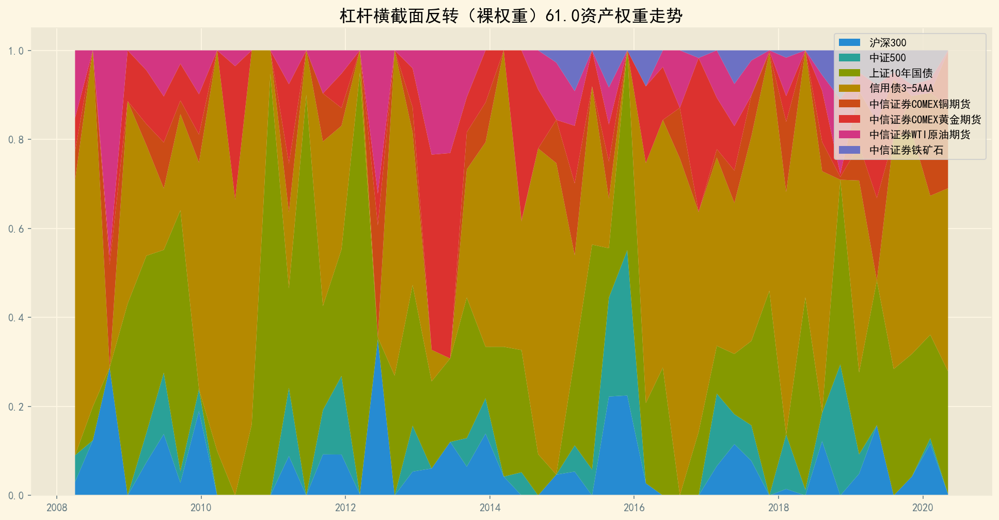

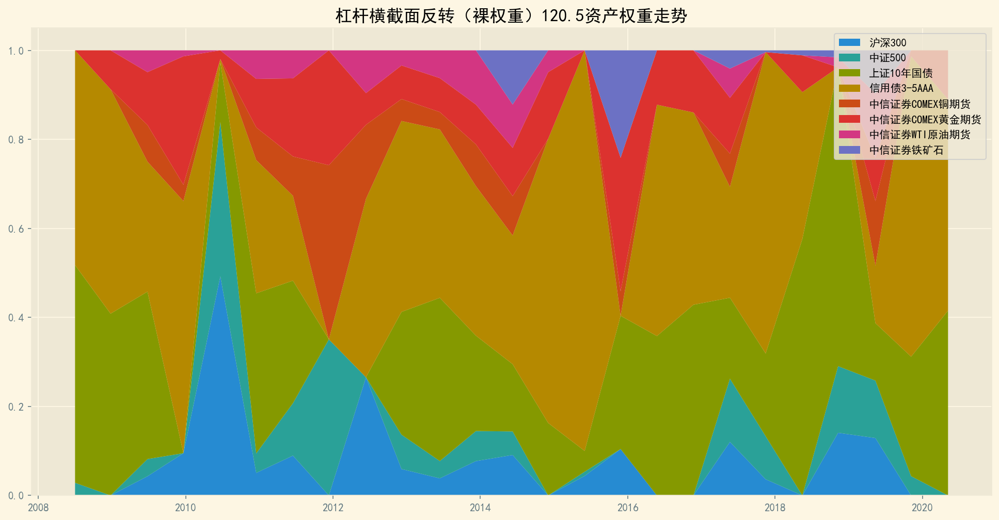

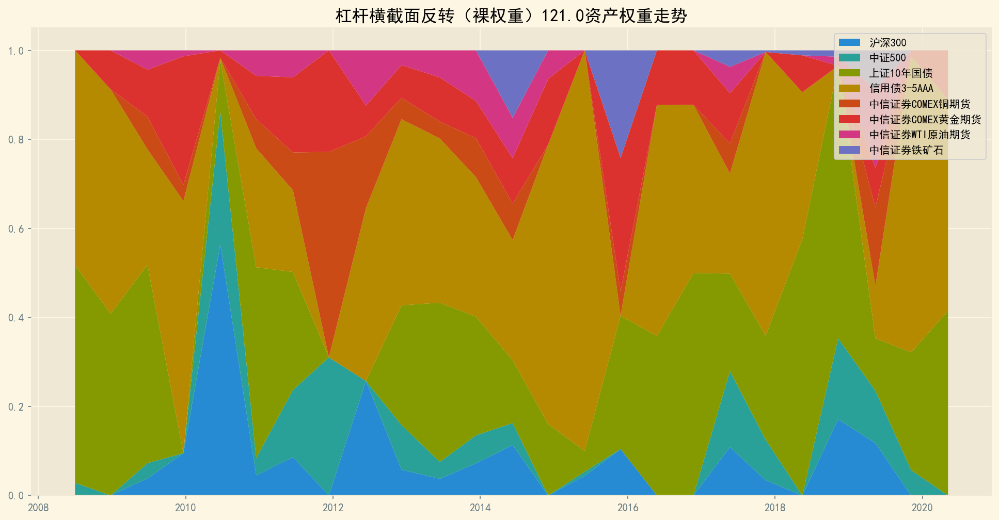

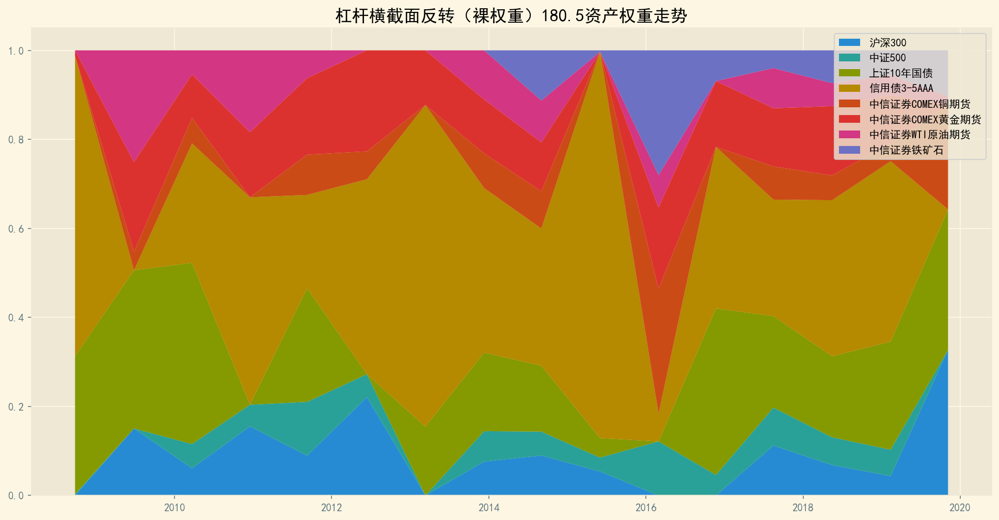

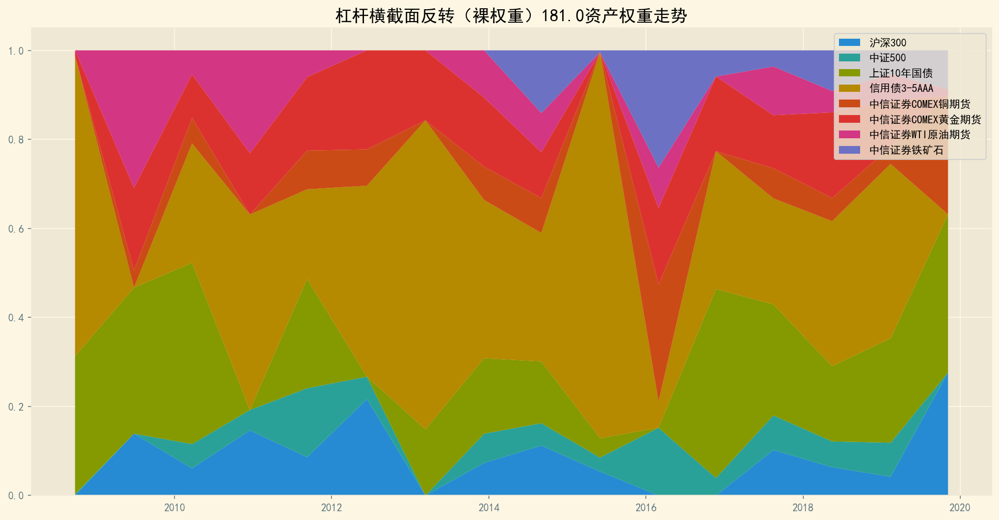

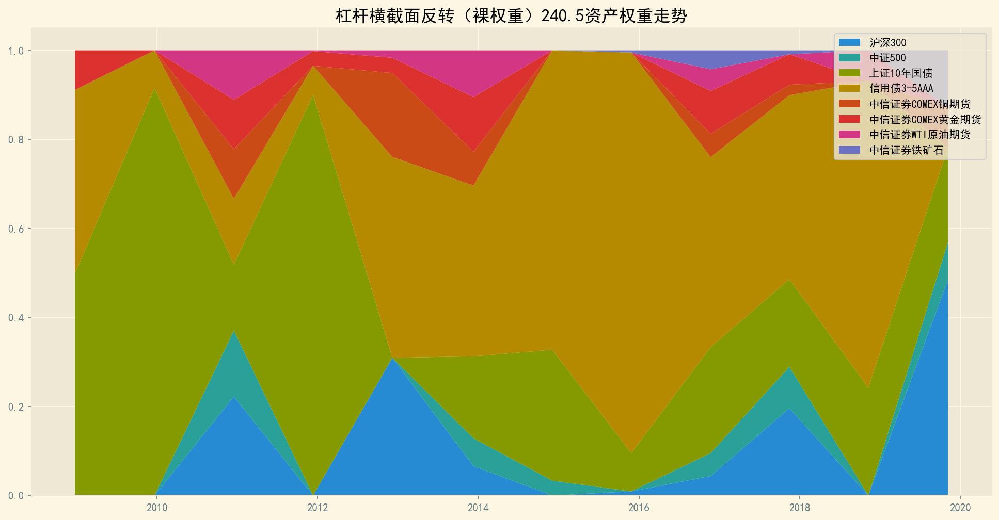

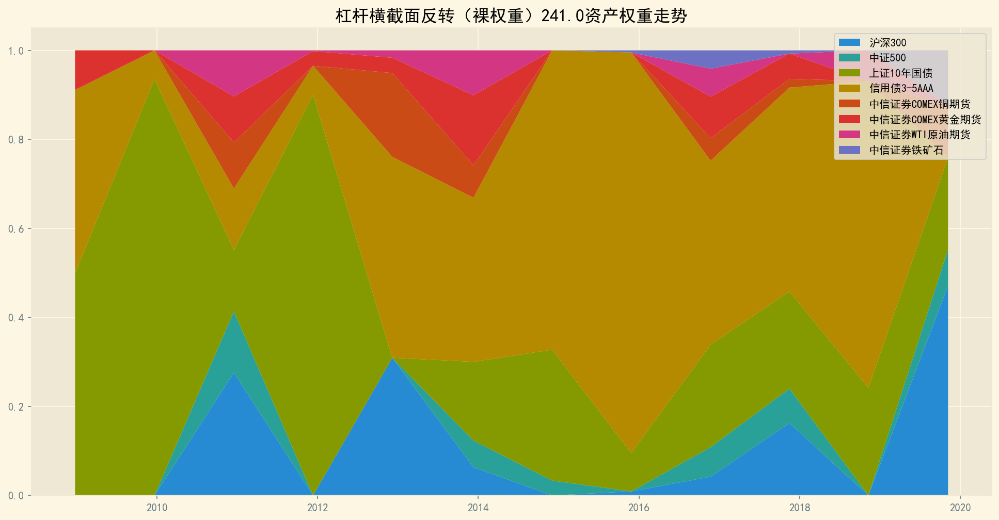

In [75]:
thrds = {'Equity':0.50, 'FixedIncome':0.90, 'Commodity':0.30}
factors = {'momentumX':False, 'momentumT':False, 
           'reverseX':True, 'reverseT':False, 
           'turnover':False, 
           'copperGold':False, 'copperGas':False}

for t in timeWindow:
    for u in ups:
        tradeDF, weightDF = AlgoLoop.AlgoTrade(Assets, leverReturns, leverCumReturns, Turnovers, 
                                               mode='plain', dt=t, up=u, thresholds=thrds, 
                                               factorDict=factors)
        StatisticFunc.WeightPlot(tradeDF, weightDF, '杠杆横截面反转（裸权重）'+str(t+u))

        leverNetValueDF_reverseX.loc[:, (t, u)] = tradeDF['投资组合净值'] / 10000  
        leverDailyPnlDF_reverseX.loc[:, (t, u)] = tradeDF['投资组合净值'] / tradeDF['投资组合净值'].shift(1) - 1.0
        leverDrawDownDF_reverseX.loc[:, (t, u)] = tradeDF['最大回撤']                      

### 回测表现汇总

In [76]:
# 汇总
leverSummaryDF_reverseX = pd.DataFrame(index=multiIDX)

leverSummaryDF_reverseX["年平均收益率"] = leverDailyPnlDF_reverseX.mean(axis=0).values * 250
leverSummaryDF_reverseX["年平均标准差"] = leverDailyPnlDF_reverseX.std(axis=0).values * np.sqrt(250)
leverSummaryDF_reverseX["无基准夏普比率"] = leverSummaryDF_reverseX["年平均收益率"] / leverSummaryDF_reverseX["年平均标准差"]
leverSummaryDF_reverseX["最大回撤"] = leverDrawDownDF_reverseX.min(axis=0).values

leverSummaryDF_reverseX

年平均收益率    年平均标准差   无基准夏普比率      最大回撤
交易周期 上调幅度                                        
20   0.5   0.051797  0.109138  0.474601 -0.355843
     1.0   0.050985  0.112755  0.452179 -0.363027
60   0.5   0.025902  0.116501  0.222331 -0.496722
     1.0   0.019542  0.120748  0.161843 -0.520625
120  0.5   0.106365  0.091878  1.157672 -0.212386
     1.0   0.104790  0.093568  1.119931 -0.212000
180  0.5   0.098796  0.088347  1.118267 -0.149984
     1.0   0.097875  0.090077  1.086573 -0.156235
240  0.5   0.053746  0.076071  0.706520 -0.220476
     1.0   0.053823  0.076333  0.705108 -0.226692

### 各投资组合净值曲线

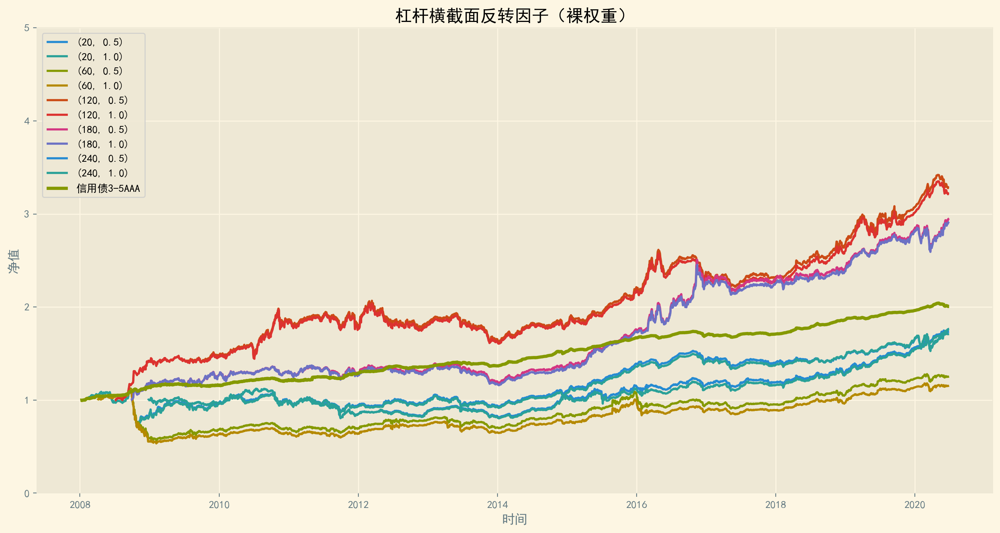

In [77]:
fig = plt.figure(figsize=(16, 8), dpi=200)

for col in leverNetValueDF_reverseX.columns:
    plt.plot(leverNetValueDF_reverseX.index, leverNetValueDF_reverseX[col], label=col)
    
plt.plot(cumReturns.index, cumReturns['信用债3-5AAA'], lw=3.0, label='信用债3-5AAA')

plt.xlabel('时间')
plt.ylabel('净值')
plt.ylim(0.0, 5.0)
plt.legend(loc='upper left')
plt.title('杠杆横截面反转因子（裸权重）')
plt.show()

## 反转因子 （时序比较）

### 程序运行

In [78]:
# 运行
timeWindow = [20, 60, 120, 180, 240]        # 调仓周期
ups = [0.50, 1.00]                          # 上调幅度

multiIDX = pd.MultiIndex.from_product([timeWindow, ups], names=['交易周期', '上调幅度'])
leverNetValueDF_reverseT = pd.DataFrame(index=Returns.index, columns=multiIDX)
leverDailyPnlDF_reverseT = pd.DataFrame(index=Returns.index, columns=multiIDX) 
leverDrawDownDF_reverseT = pd.DataFrame(index=Returns.index, columns=multiIDX)

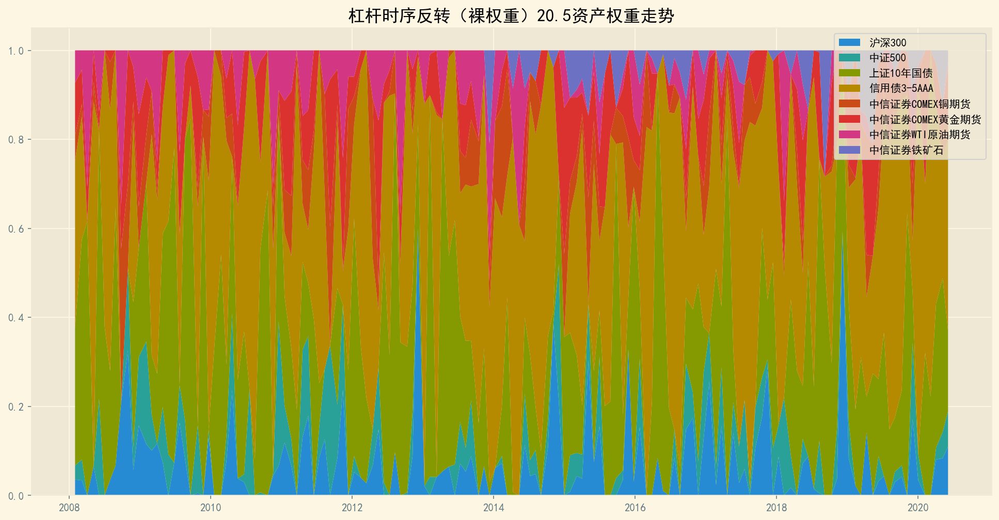

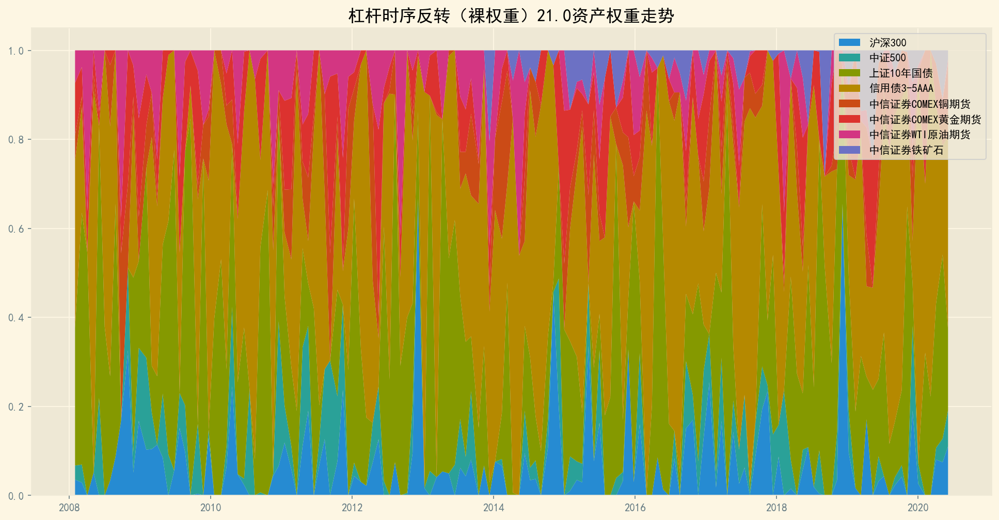

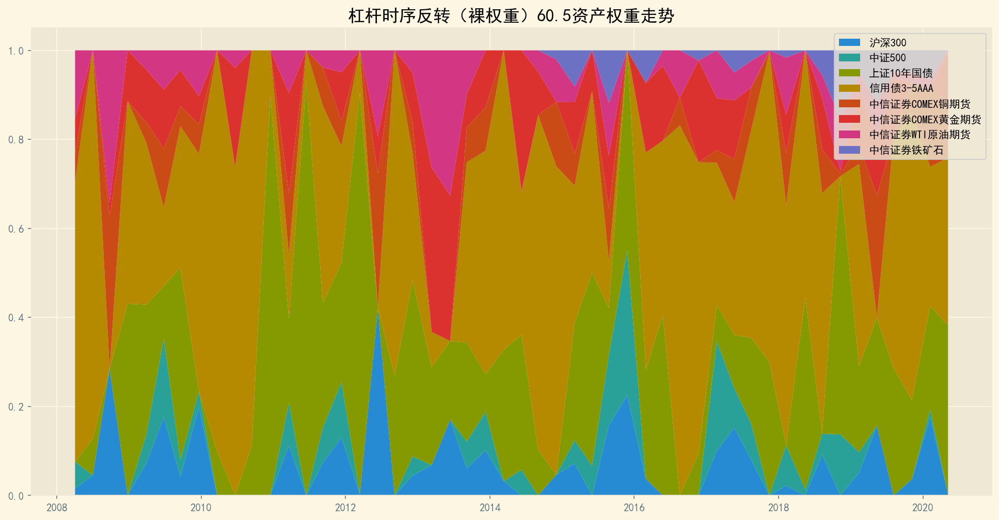

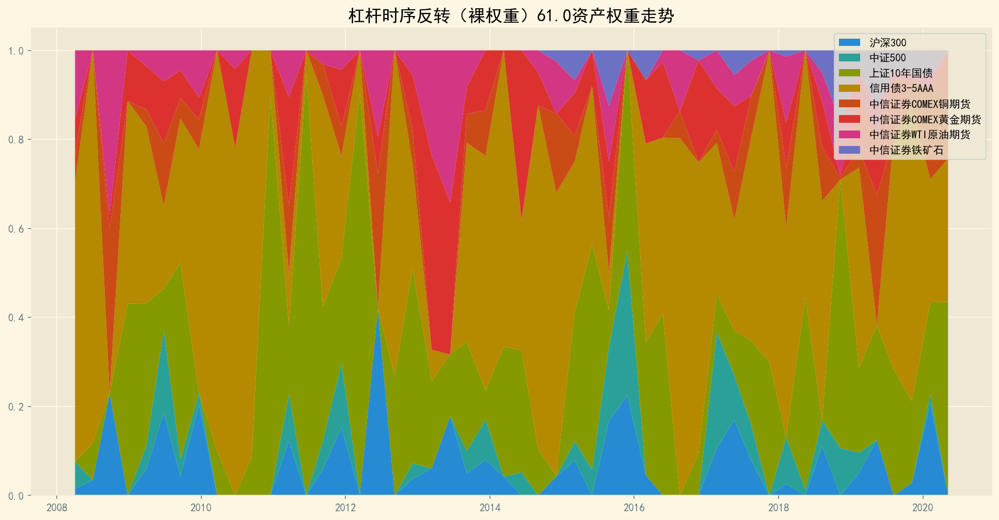

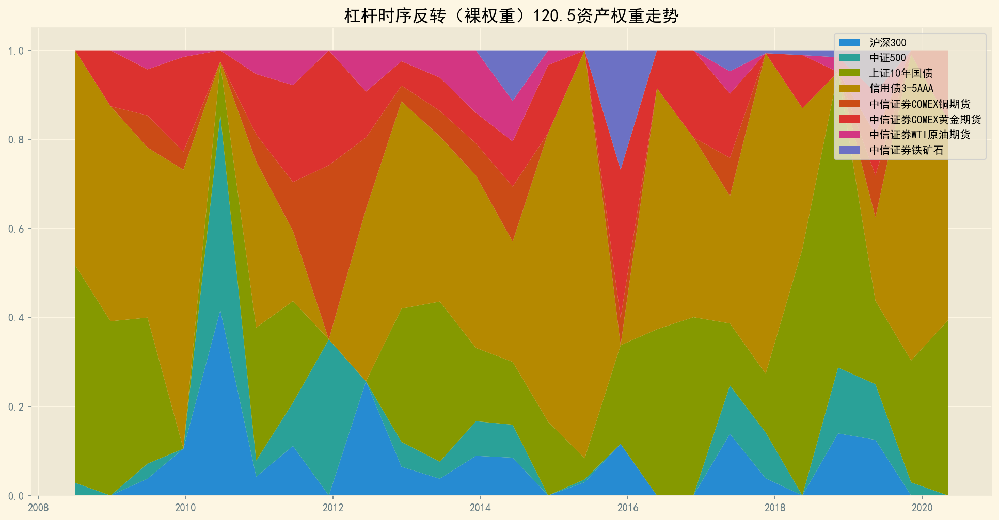

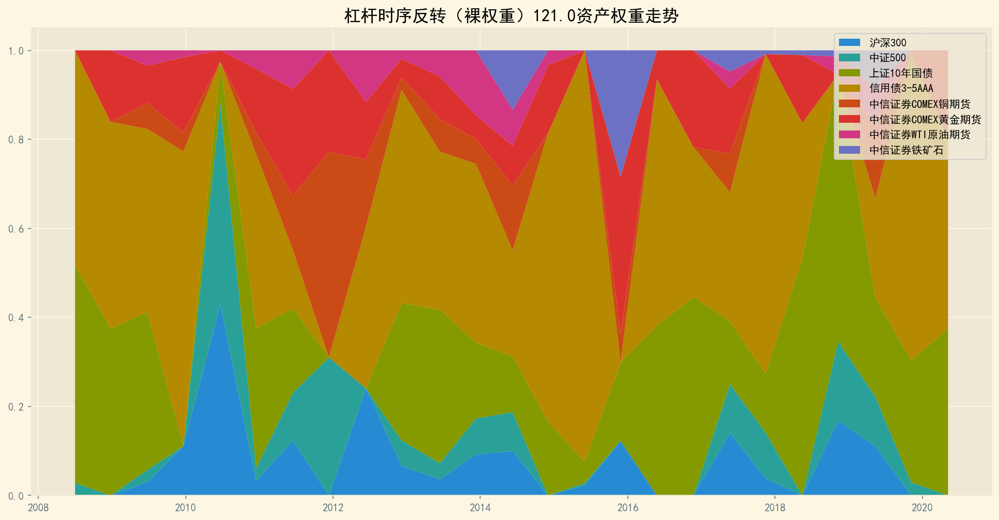

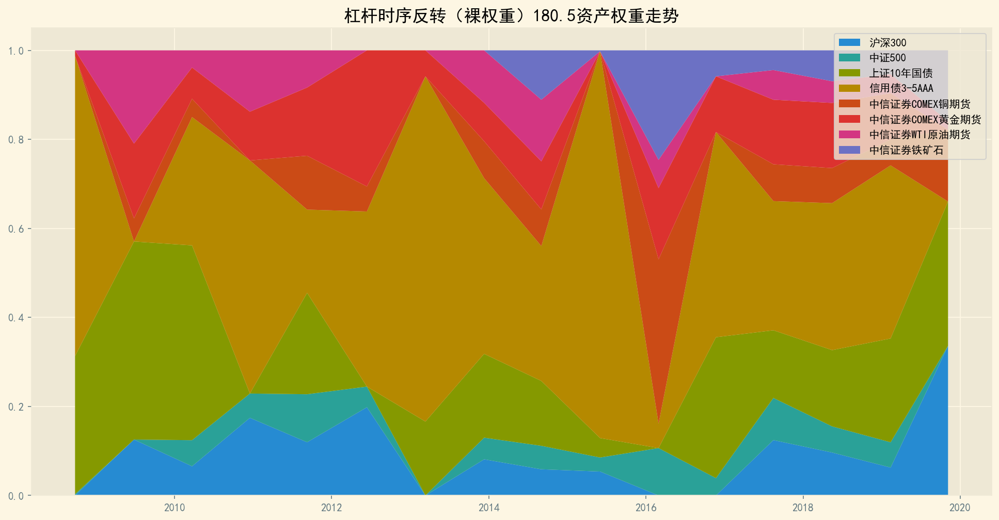

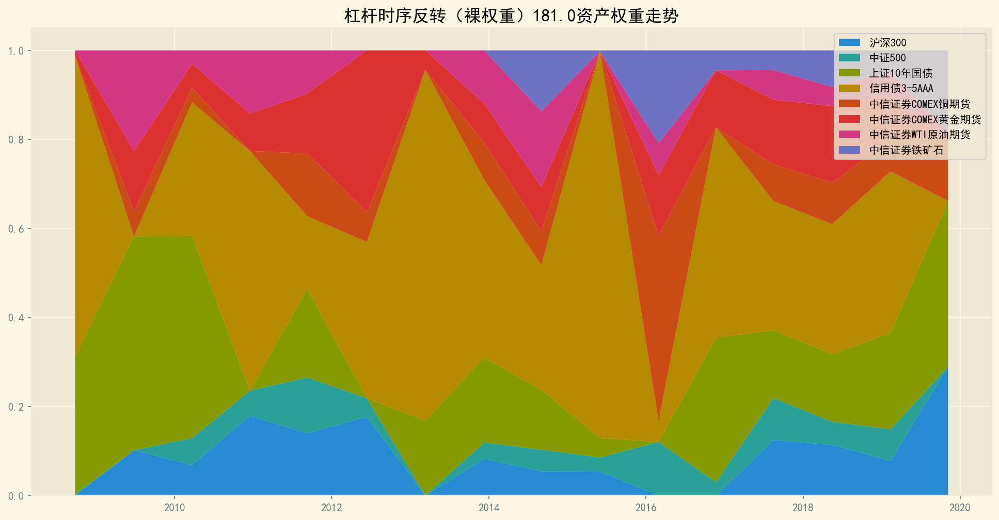

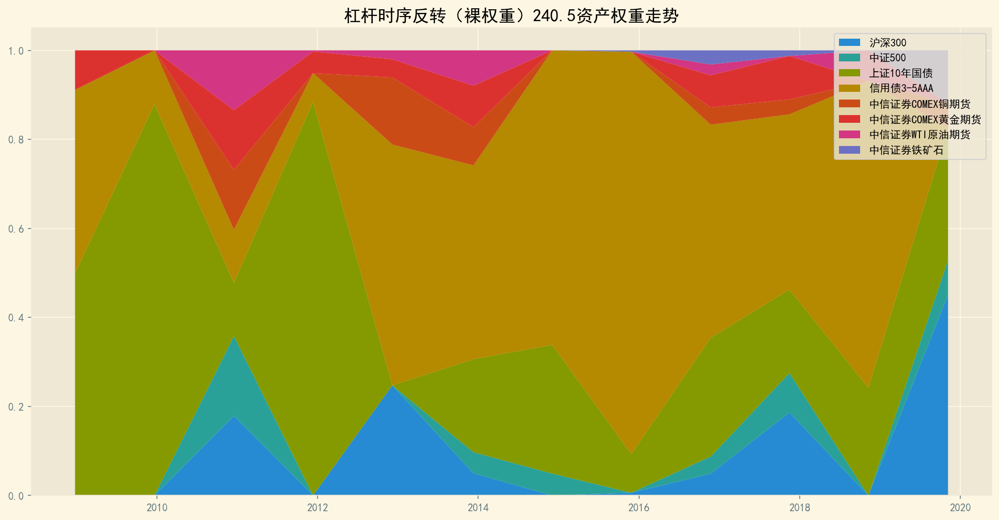

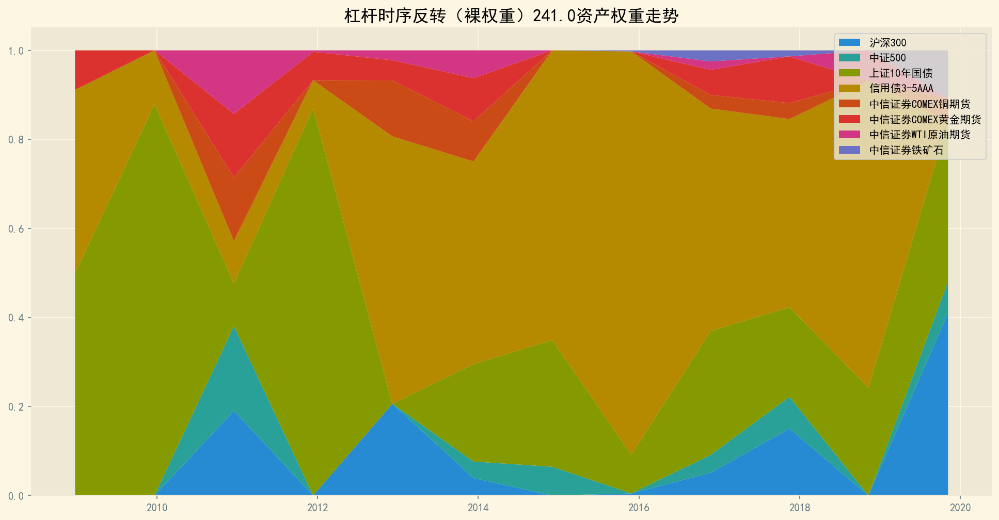

In [79]:
thrds = {'Equity':0.50, 'FixedIncome':0.90, 'Commodity':0.30}
factors = {'momentumX':False, 'momentumT':False, 
           'reverseX':False, 'reverseT':True, 
           'turnover':False, 
           'copperGold':False, 'copperGas':False}

for t in timeWindow:
    for u in ups:
        tradeDF, weightDF = AlgoLoop.AlgoTrade(Assets, leverReturns, leverCumReturns, Turnovers, 
                                               mode='plain', dt=t, up=u, thresholds=thrds, 
                                               factorDict=factors)
        StatisticFunc.WeightPlot(tradeDF, weightDF, '杠杆时序反转（裸权重）'+str(t+u))

        leverNetValueDF_reverseT.loc[:, (t, u)] = tradeDF['投资组合净值'] / 10000  
        leverDailyPnlDF_reverseT.loc[:, (t, u)] = tradeDF['投资组合净值'] / tradeDF['投资组合净值'].shift(1) - 1.0
        leverDrawDownDF_reverseT.loc[:, (t, u)] = tradeDF['最大回撤']                      

### 回测表现汇总

In [80]:
# 汇总
leverSummaryDF_reverseT = pd.DataFrame(index=multiIDX)

leverSummaryDF_reverseT["年平均收益率"] = leverDailyPnlDF_reverseT.mean(axis=0).values * 250
leverSummaryDF_reverseT["年平均标准差"] = leverDailyPnlDF_reverseT.std(axis=0).values * np.sqrt(250)
leverSummaryDF_reverseT["无基准夏普比率"] = leverSummaryDF_reverseT["年平均收益率"] / leverSummaryDF_reverseT["年平均标准差"]
leverSummaryDF_reverseT["最大回撤"] = leverDrawDownDF_reverseT.min(axis=0).values

leverSummaryDF_reverseT

年平均收益率    年平均标准差   无基准夏普比率      最大回撤
交易周期 上调幅度                                        
20   0.5   0.055679  0.110586  0.503491 -0.363762
     1.0   0.057520  0.114330  0.503104 -0.376789
60   0.5   0.028003  0.117862  0.237587 -0.507363
     1.0   0.023594  0.122386  0.192784 -0.532228
120  0.5   0.111472  0.092777  1.201509 -0.206899
     1.0   0.113455  0.094948  1.194925 -0.203882
180  0.5   0.091616  0.086653  1.057272 -0.149600
     1.0   0.085528  0.087215  0.980665 -0.175069
240  0.5   0.053396  0.073590  0.725590 -0.226253
     1.0   0.053717  0.072444  0.741501 -0.234568

### 各投资组合净值曲线

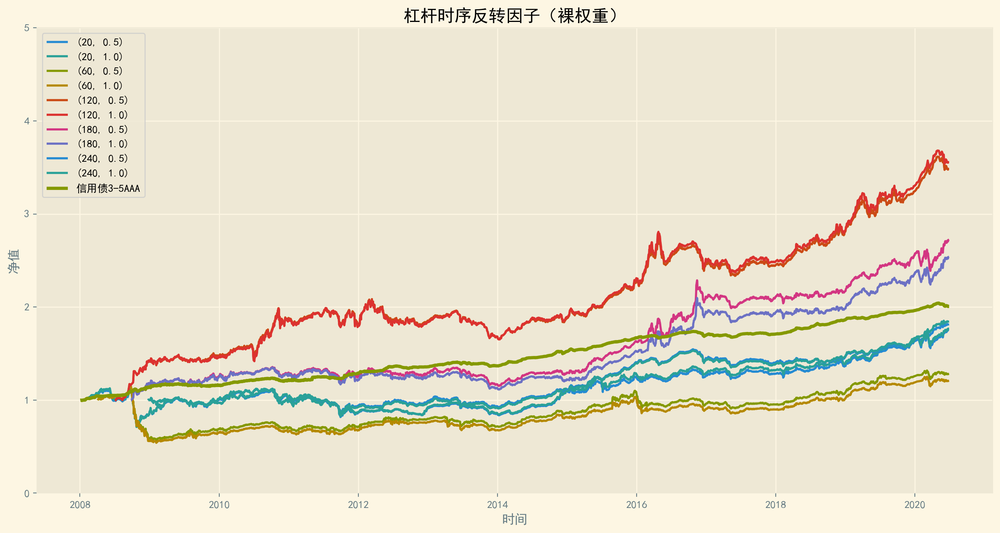

In [81]:
fig = plt.figure(figsize=(16, 8), dpi=200)

for col in leverNetValueDF_reverseT.columns:
    plt.plot(leverNetValueDF_reverseT.index, leverNetValueDF_reverseT[col], label=col)

plt.plot(cumReturns.index, cumReturns['信用债3-5AAA'], lw=3.0, label='信用债3-5AAA')
    
plt.xlabel('时间')
plt.ylabel('净值')
plt.ylim(0.0, 5.0)
plt.legend(loc='upper left')
plt.title('杠杆时序反转因子（裸权重）')
plt.show()

## 情绪因子（股指换手率）

### 程序运行

In [82]:
# 运行
timeWindow = [20, 60, 120, 180, 240]        # 调仓周期
ups = [0.50, 1.00]                          # 上调幅度

multiIDX = pd.MultiIndex.from_product([timeWindow, ups], names=['交易周期', '上调幅度'])
leverNetValueDF_turnover = pd.DataFrame(index=Returns.index, columns=multiIDX)
leverDailyPnlDF_turnover = pd.DataFrame(index=Returns.index, columns=multiIDX) 
leverDrawDownDF_turnover = pd.DataFrame(index=Returns.index, columns=multiIDX)

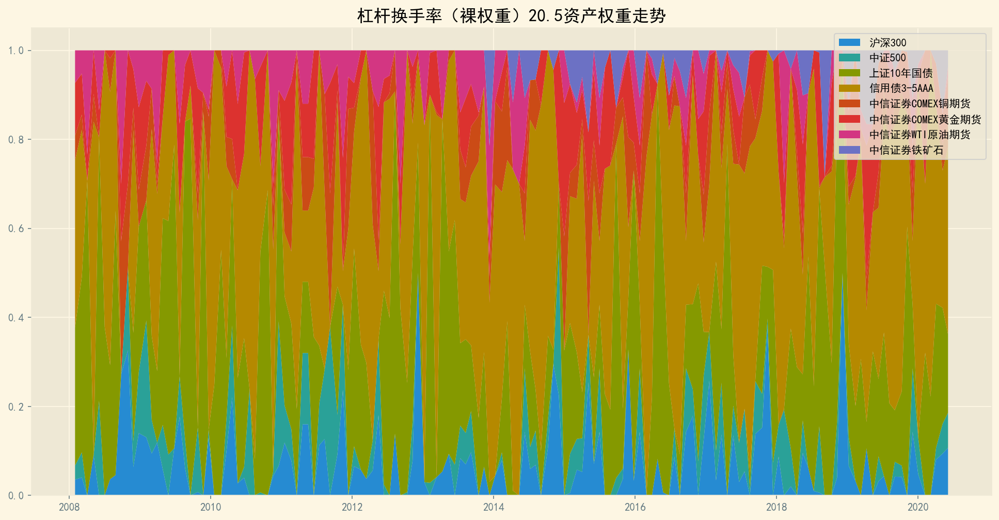

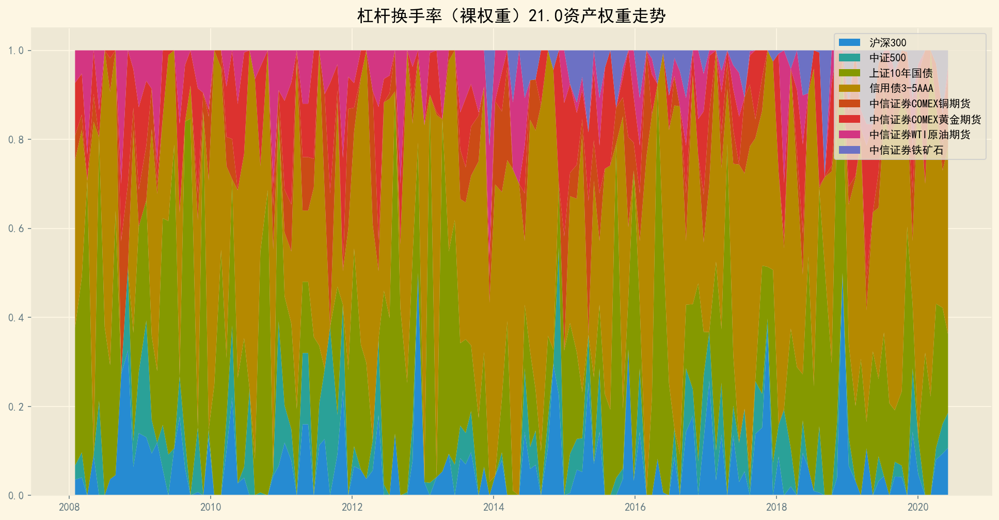

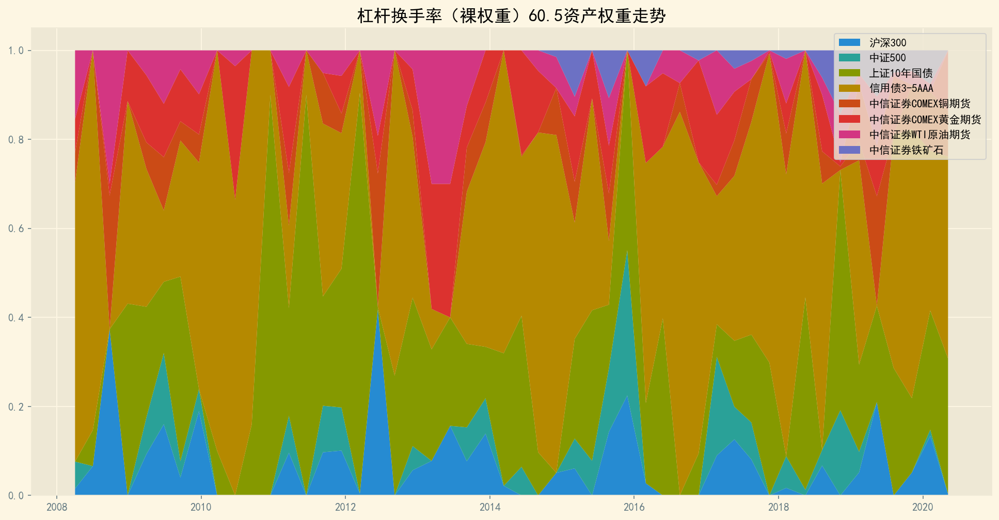

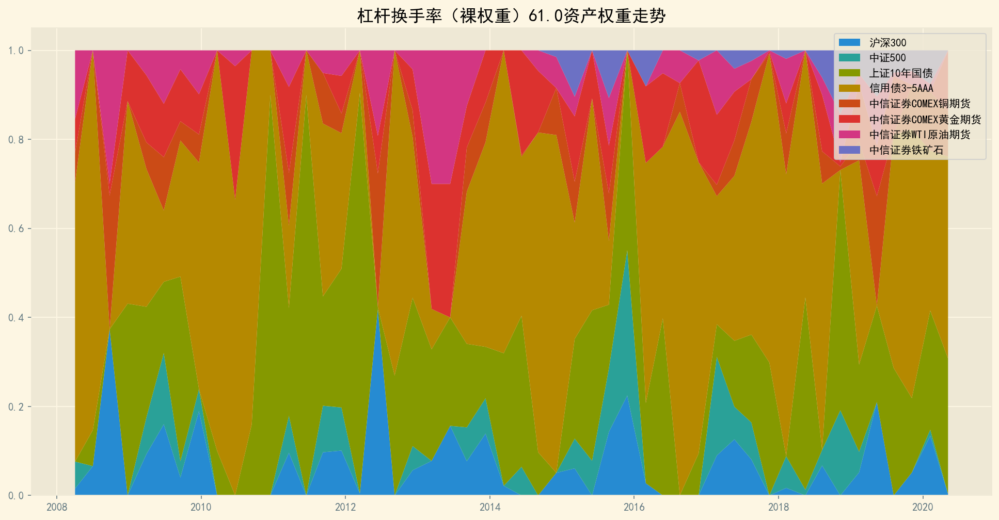

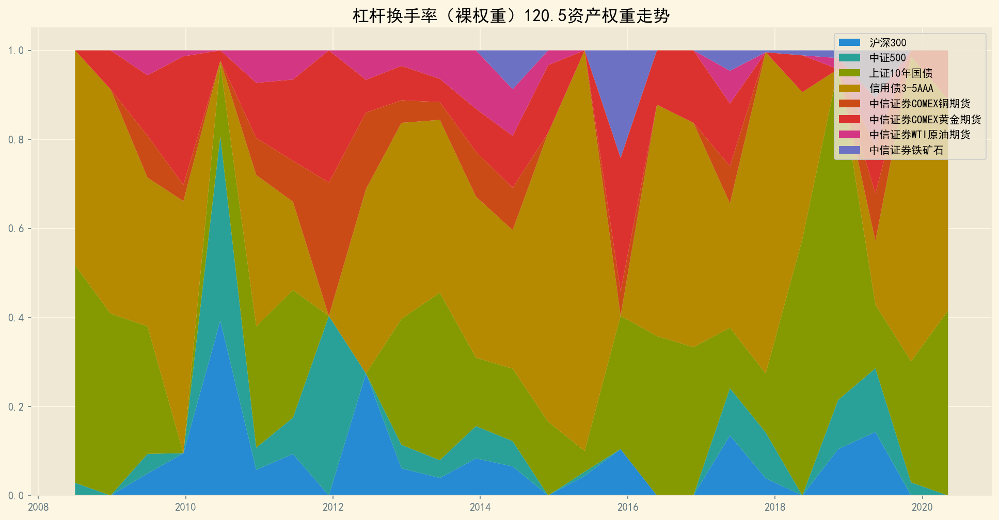

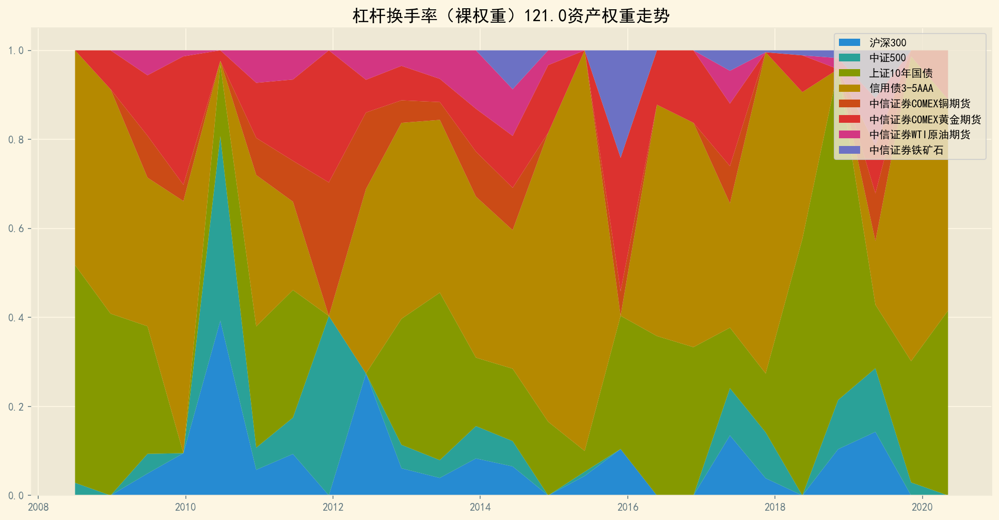

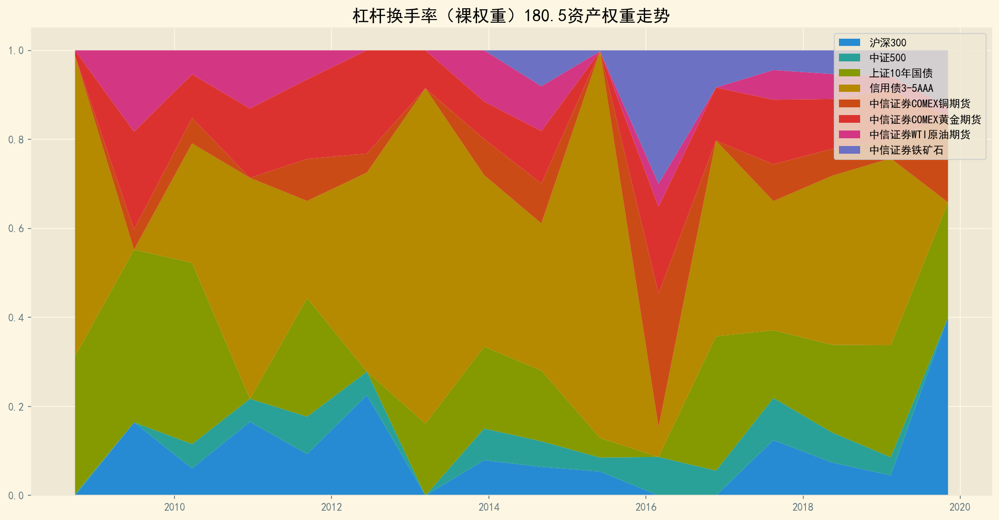

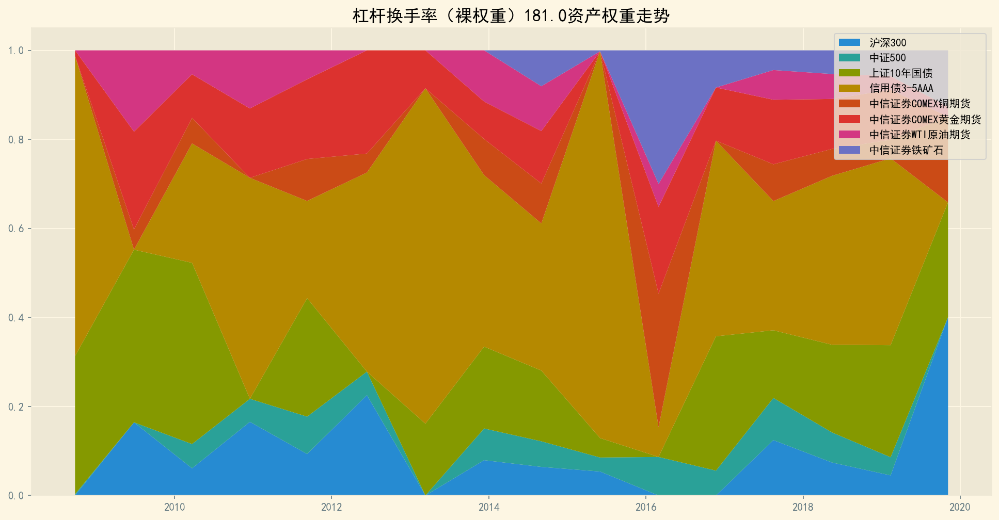

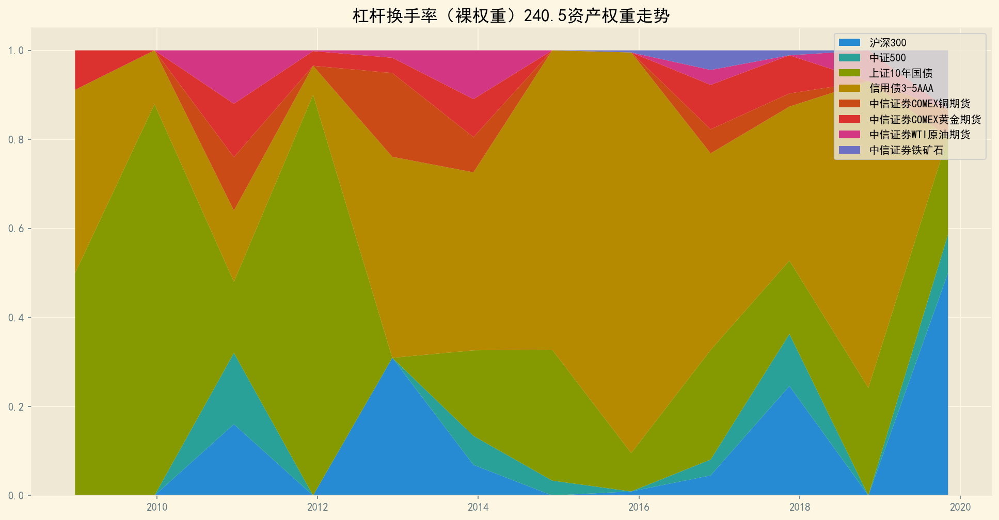

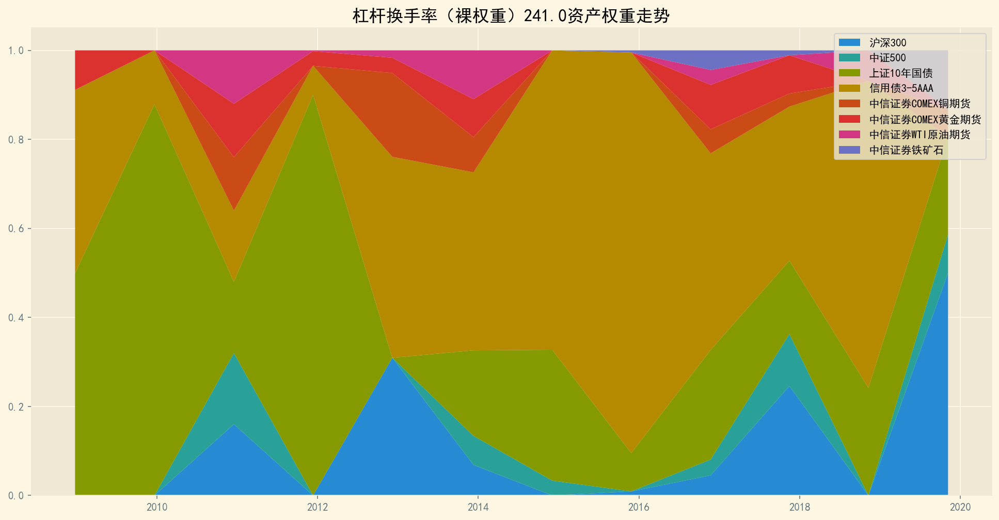

In [83]:
thrds = {'Equity':0.50, 'FixedIncome':0.90, 'Commodity':0.30}
factors = {'momentumX':False, 'momentumT':False, 
           'reverseX':False, 'reverseT':False, 
           'turnover':True, 
           'copperGold':False, 'copperGas':False}

for t in timeWindow:
    for u in ups:
        tradeDF, weightDF = AlgoLoop.AlgoTrade(Assets, leverReturns, leverCumReturns, Turnovers, 
                                               mode='plain', dt=t, up=u, thresholds=thrds, 
                                               factorDict=factors)
        StatisticFunc.WeightPlot(tradeDF, weightDF, '杠杆换手率（裸权重）'+str(t+u))

        leverNetValueDF_turnover.loc[:, (t, u)] = tradeDF['投资组合净值'] / 10000  
        leverDailyPnlDF_turnover.loc[:, (t, u)] = tradeDF['投资组合净值'] / tradeDF['投资组合净值'].shift(1) - 1.0
        leverDrawDownDF_turnover.loc[:, (t, u)] = tradeDF['最大回撤']                      

### 回测表现汇总

In [84]:
# 汇总
leverSummaryDF_turnover = pd.DataFrame(index=multiIDX)

leverSummaryDF_turnover["年平均收益率"] = leverDailyPnlDF_turnover.mean(axis=0).values * 250
leverSummaryDF_turnover["年平均标准差"] = leverDailyPnlDF_turnover.std(axis=0).values * np.sqrt(250)
leverSummaryDF_turnover["无基准夏普比率"] = leverSummaryDF_turnover["年平均收益率"] / leverSummaryDF_turnover["年平均标准差"]
leverSummaryDF_turnover["最大回撤"] = leverDrawDownDF_turnover.min(axis=0).values

leverSummaryDF_turnover

年平均收益率    年平均标准差   无基准夏普比率      最大回撤
交易周期 上调幅度                                        
20   0.5   0.052636  0.105915  0.496969 -0.346505
     1.0   0.052636  0.105915  0.496969 -0.346505
60   0.5   0.033492  0.112517  0.297665 -0.466683
     1.0   0.033492  0.112517  0.297665 -0.466683
120  0.5   0.108418  0.090659  1.195889 -0.212343
     1.0   0.108418  0.090659  1.195889 -0.212343
180  0.5   0.100009  0.087690  1.140493 -0.146184
     1.0   0.100009  0.087690  1.140493 -0.146184
240  0.5   0.052926  0.076260  0.694029 -0.212285
     1.0   0.052926  0.076260  0.694029 -0.212285

### 各投资组合净值曲线

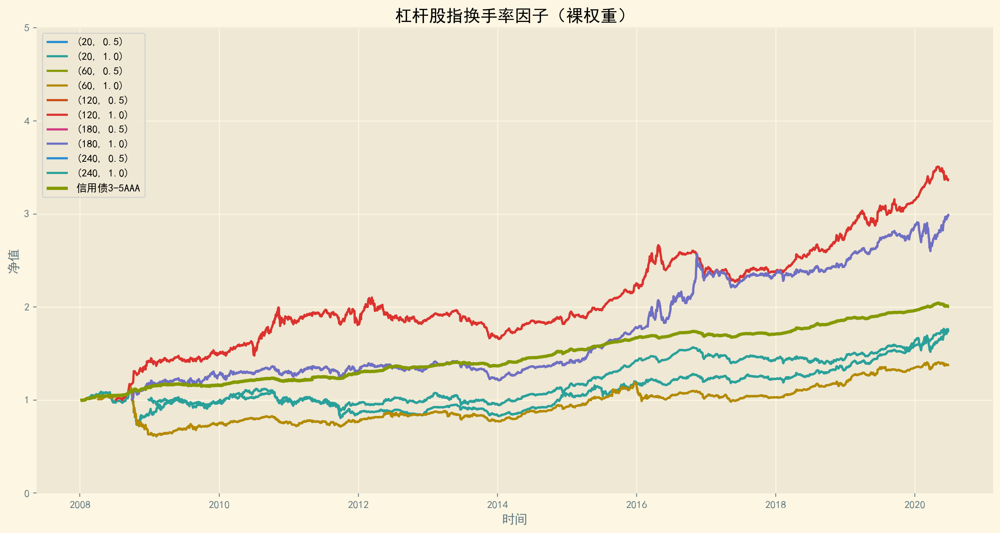

In [85]:
fig = plt.figure(figsize=(16, 8), dpi=200)

for col in leverNetValueDF_turnover.columns:
    plt.plot(leverNetValueDF_turnover.index, leverNetValueDF_turnover[col], label=col)
    
plt.plot(cumReturns.index, cumReturns['信用债3-5AAA'], lw=3.0, label='信用债3-5AAA')

plt.xlabel('时间')
plt.ylabel('净值')
plt.ylim(0.0, 5.0)
plt.legend(loc='upper left')
plt.title('杠杆股指换手率因子（裸权重）')
plt.show()

## 铜金价格比因子（十年国债反转）

### 程序运行

In [86]:
# 运行
timeWindow = [20, 60, 120, 180, 240]        # 调仓周期
ups = [0.50, 1.00]                          # 上调幅度

multiIDX = pd.MultiIndex.from_product([timeWindow, ups], names=['交易周期', '上调幅度'])
leverNetValueDF_copperGold = pd.DataFrame(index=Returns.index, columns=multiIDX)
leverDailyPnlDF_copperGold = pd.DataFrame(index=Returns.index, columns=multiIDX) 
leverDrawDownDF_copperGold = pd.DataFrame(index=Returns.index, columns=multiIDX)

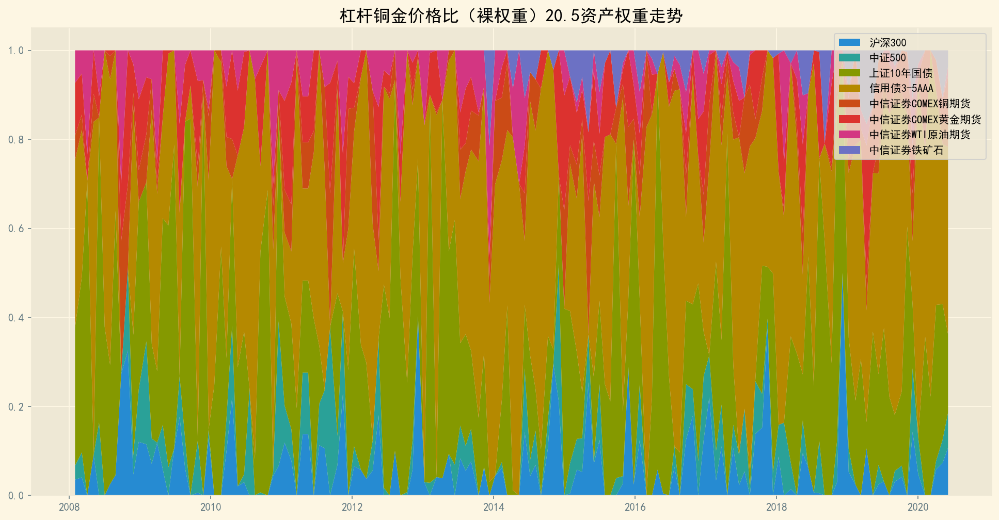

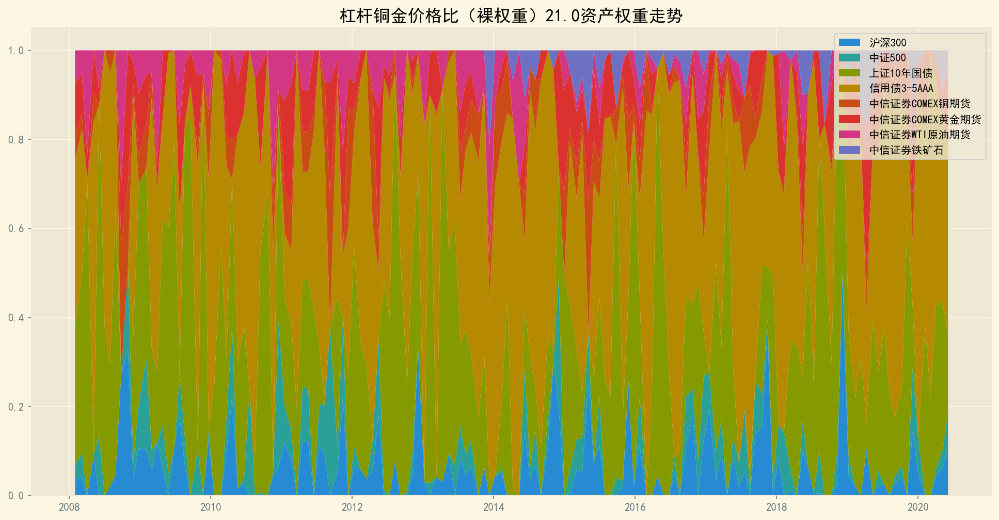

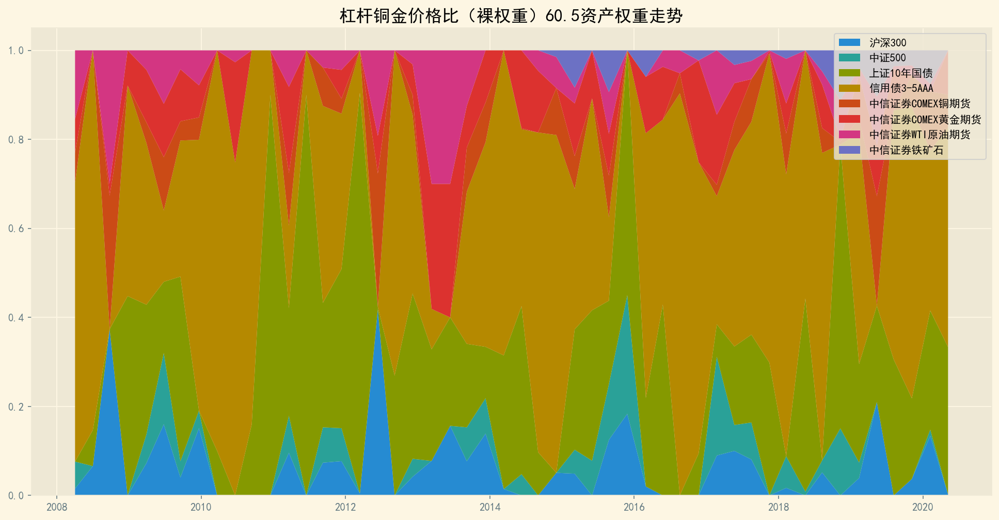

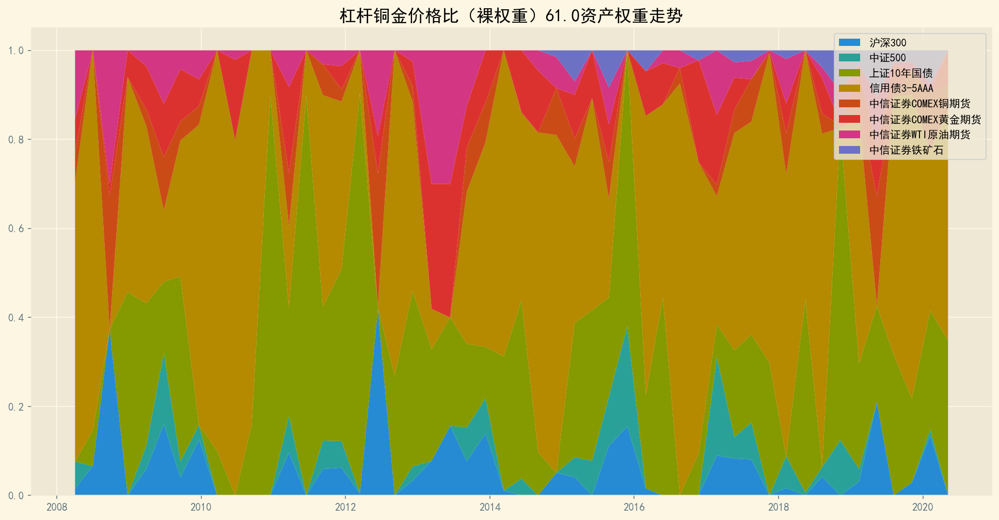

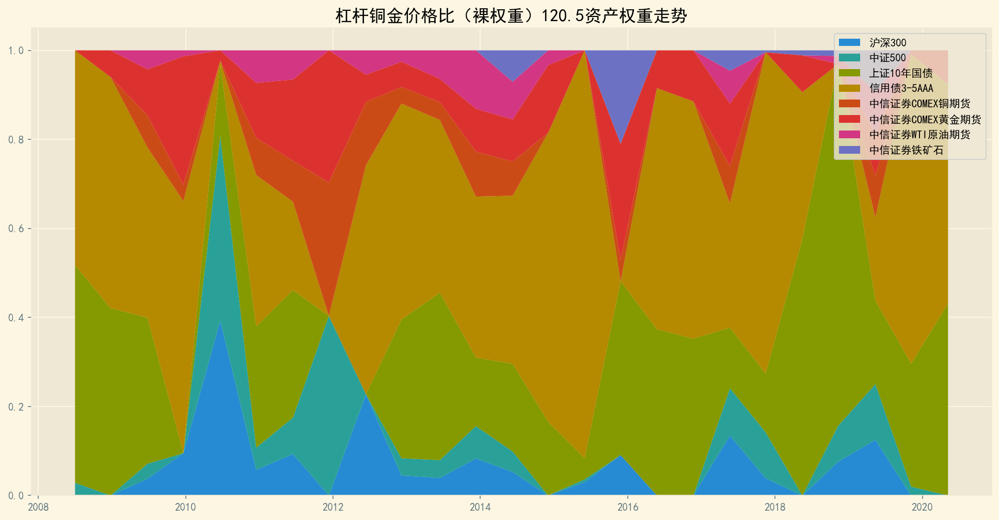

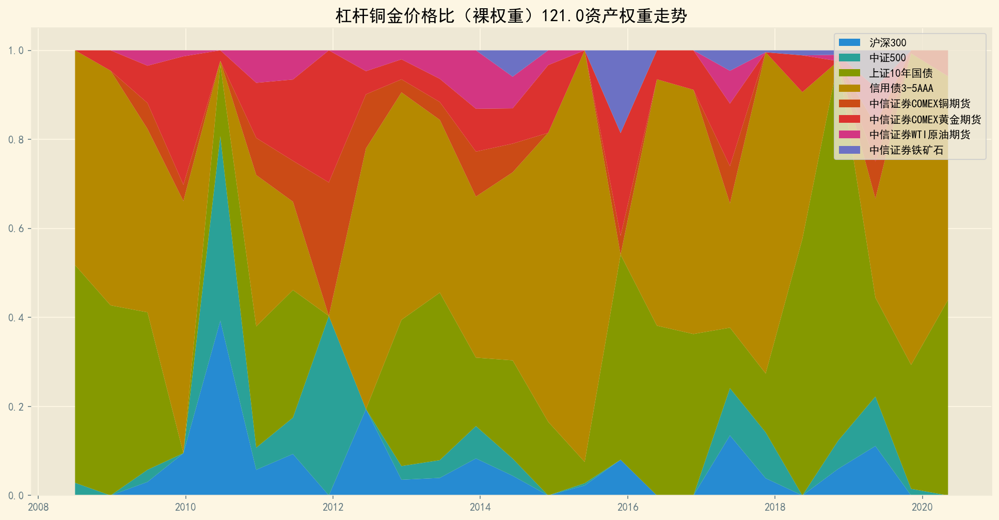

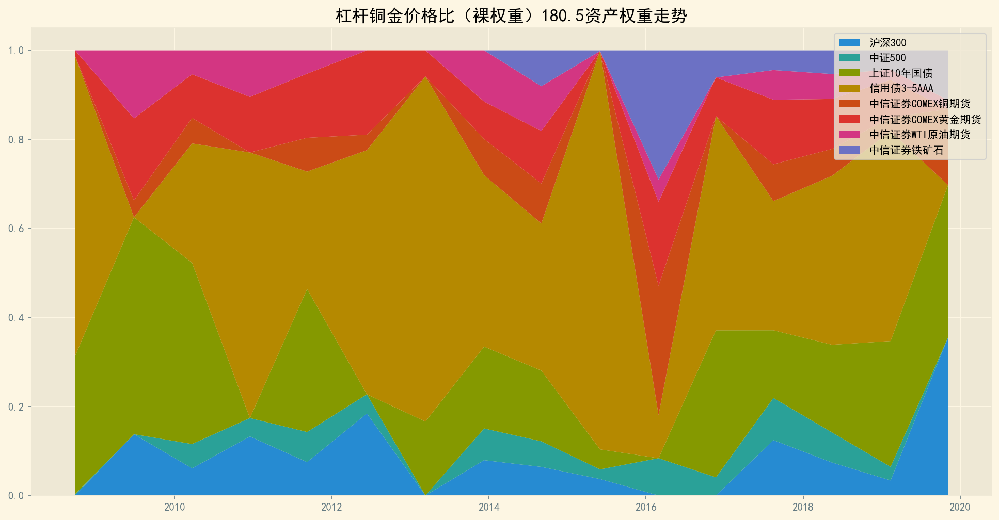

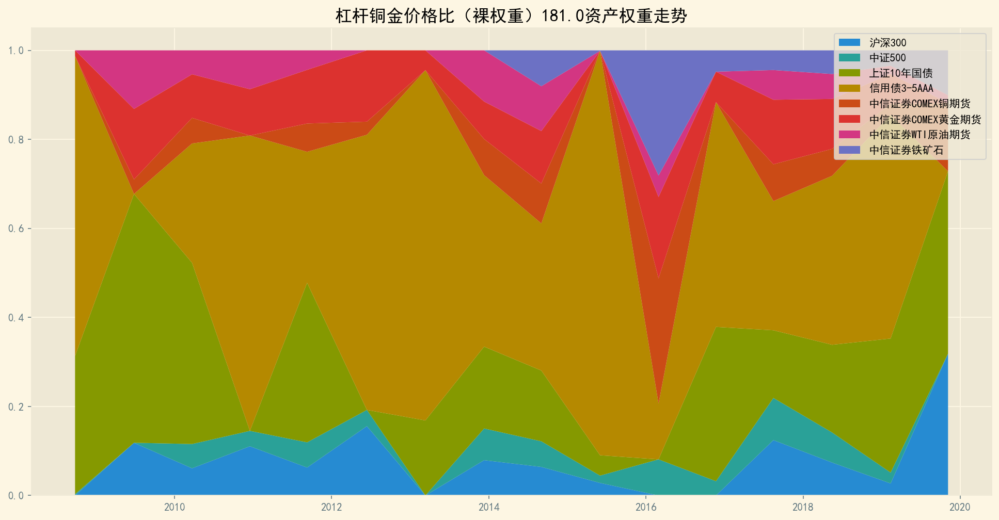

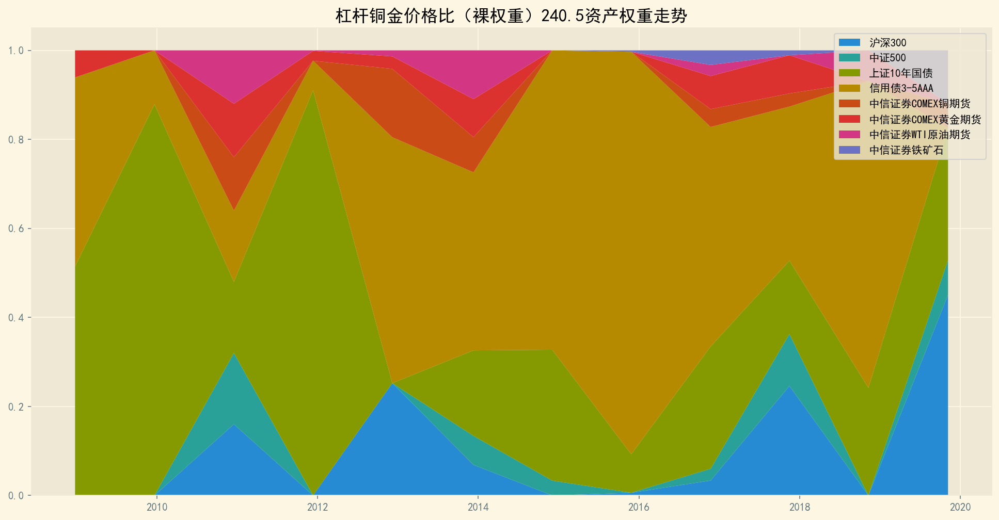

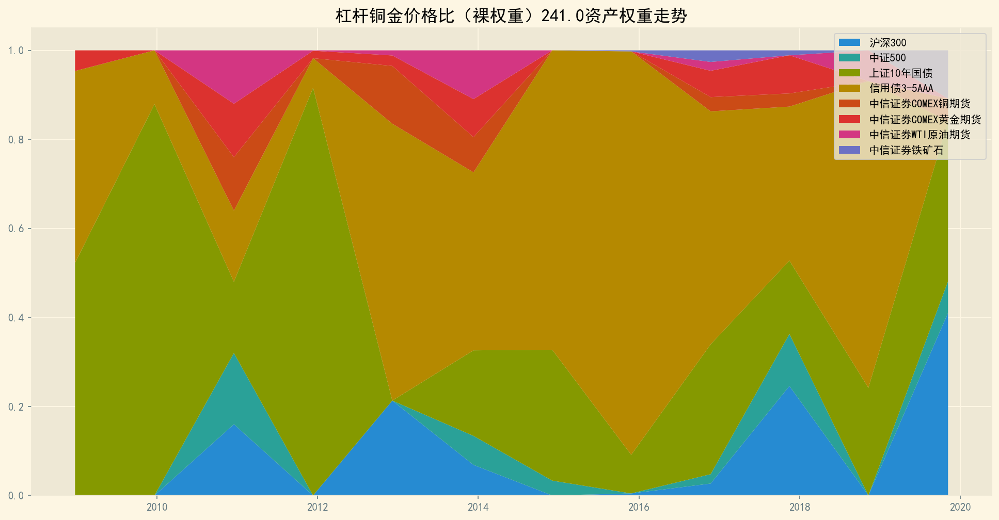

In [87]:
thrds = {'Equity':0.50, 'FixedIncome':0.90, 'Commodity':0.30}
factors = {'momentumX':False, 'momentumT':False, 
            'reverseX':False, 'reverseT':False,
            'turnover':False, 
            'copperGold':True, 'copperGas':False}

for t in timeWindow:
    for u in ups:
        tradeDF, weightDF = AlgoLoop.AlgoTrade(Assets, leverReturns, leverCumReturns, Turnovers, 
                                               mode='plain', dt=t, up=u, thresholds=thrds, 
                                               factorDict=factors)
        StatisticFunc.WeightPlot(tradeDF, weightDF, '杠杆铜金价格比（裸权重）'+str(t+u))

        leverNetValueDF_copperGold.loc[:, (t, u)] = tradeDF['投资组合净值'] / 10000  
        leverDailyPnlDF_copperGold.loc[:, (t, u)] = tradeDF['投资组合净值'] / tradeDF['投资组合净值'].shift(1) - 1.0
        leverDrawDownDF_copperGold.loc[:, (t, u)] = tradeDF['最大回撤']                      

### 回测表现汇总

In [88]:
# 汇总
leverSummaryDF_copperGold = pd.DataFrame(index=multiIDX)

leverSummaryDF_copperGold["年平均收益率"] = leverDailyPnlDF_copperGold.mean(axis=0).values * 250
leverSummaryDF_copperGold["年平均标准差"] = leverDailyPnlDF_copperGold.std(axis=0).values * np.sqrt(250)
leverSummaryDF_copperGold["无基准夏普比率"] = leverSummaryDF_copperGold["年平均收益率"] / leverSummaryDF_copperGold["年平均标准差"]
leverSummaryDF_copperGold["最大回撤"] = leverDrawDownDF_copperGold.min(axis=0).values

leverSummaryDF_copperGold

年平均收益率    年平均标准差   无基准夏普比率      最大回撤
交易周期 上调幅度                                        
20   0.5   0.051003  0.102880  0.495753 -0.346505
     1.0   0.049695  0.101250  0.490813 -0.346505
60   0.5   0.033695  0.109229  0.308484 -0.469106
     1.0   0.033921  0.107550  0.315398 -0.470391
120  0.5   0.106554  0.088154  1.208720 -0.207321
     1.0   0.105376  0.086803  1.213966 -0.204362
180  0.5   0.101859  0.082307  1.237543 -0.145600
     1.0   0.102747  0.079139  1.298306 -0.146462
240  0.5   0.050137  0.072939  0.687382 -0.212285
     1.0   0.048488  0.070831  0.684570 -0.212285

### 各投资组合净值曲线

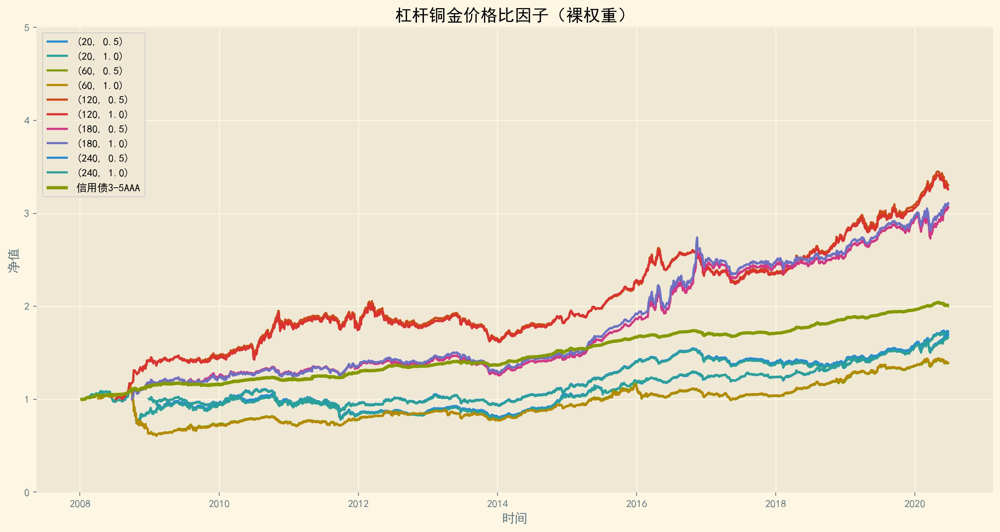

In [89]:
fig = plt.figure(figsize=(16, 8), dpi=200)

for col in leverNetValueDF_copperGold.columns:
    plt.plot(leverNetValueDF_copperGold.index, leverNetValueDF_copperGold[col], label=col)
    
plt.plot(cumReturns.index, cumReturns['信用债3-5AAA'], lw=3.0, label='信用债3-5AAA')

plt.xlabel('时间')
plt.ylabel('净值')
plt.ylim(0.0, 5.0)
plt.legend(loc='upper left')
plt.title('杠杆铜金价格比因子（裸权重）')
plt.show()

## 铜油价格比因子（沪深300动量）

### 程序运行

In [25]:
# 运行
timeWindow = [20, 60, 120, 180, 240]        # 调仓周期
ups = [0.50, 1.00]                          # 上调幅度

multiIDX = pd.MultiIndex.from_product([timeWindow, ups], names=['交易周期', '上调幅度'])
leverNetValueDF_copperGas = pd.DataFrame(index=Returns.index, columns=multiIDX)
leverDailyPnlDF_copperGas = pd.DataFrame(index=Returns.index, columns=multiIDX) 
leverDrawDownDF_copperGas = pd.DataFrame(index=Returns.index, columns=multiIDX)

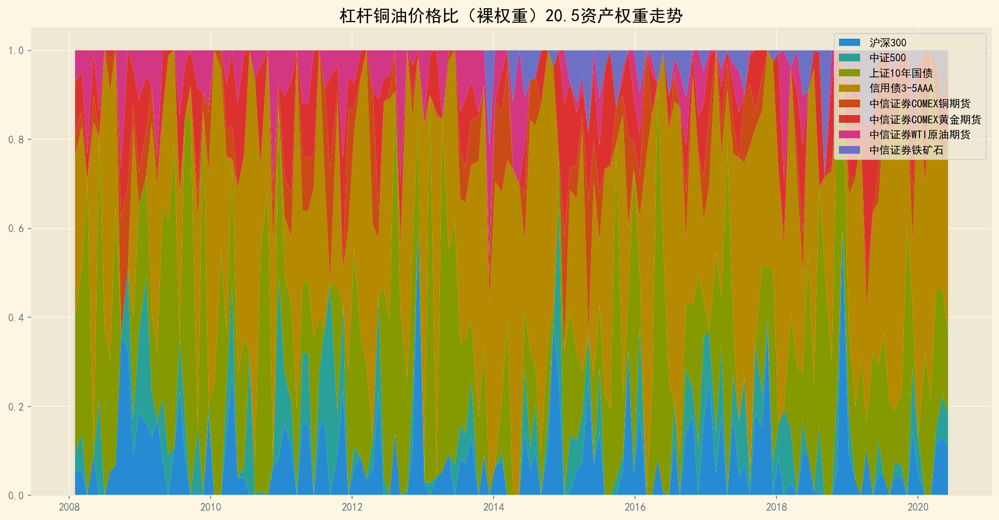

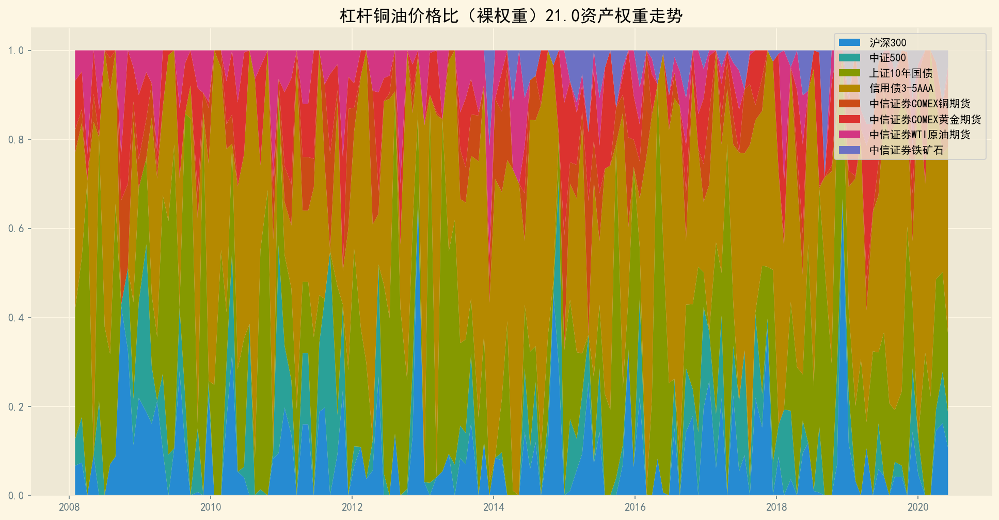

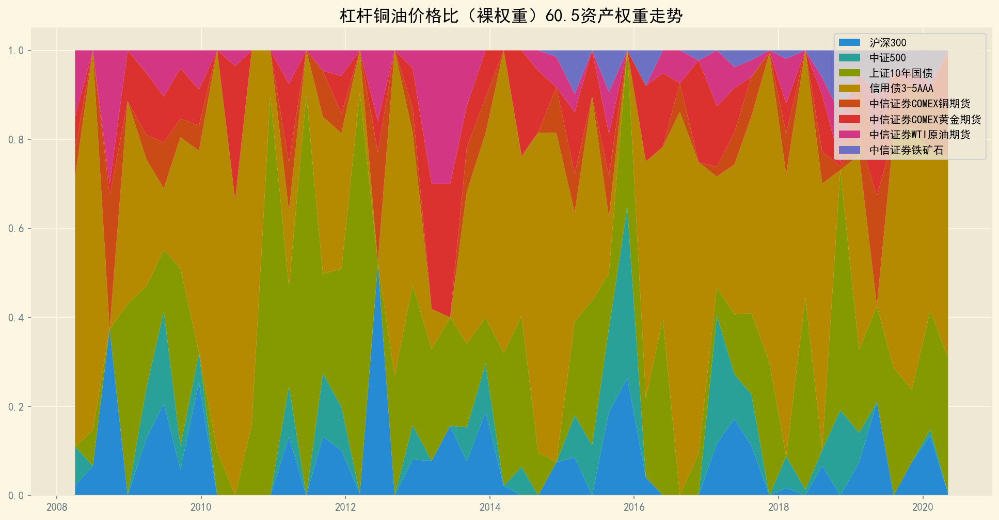

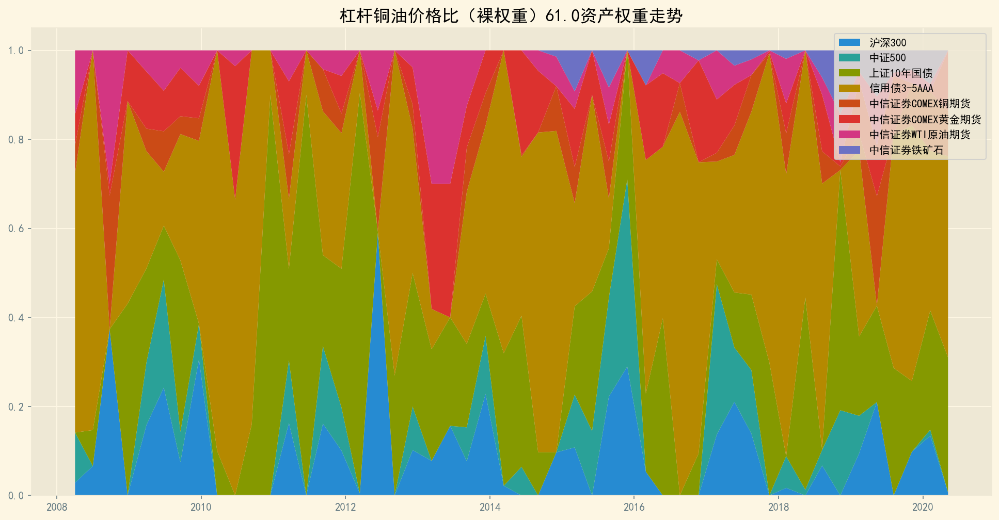

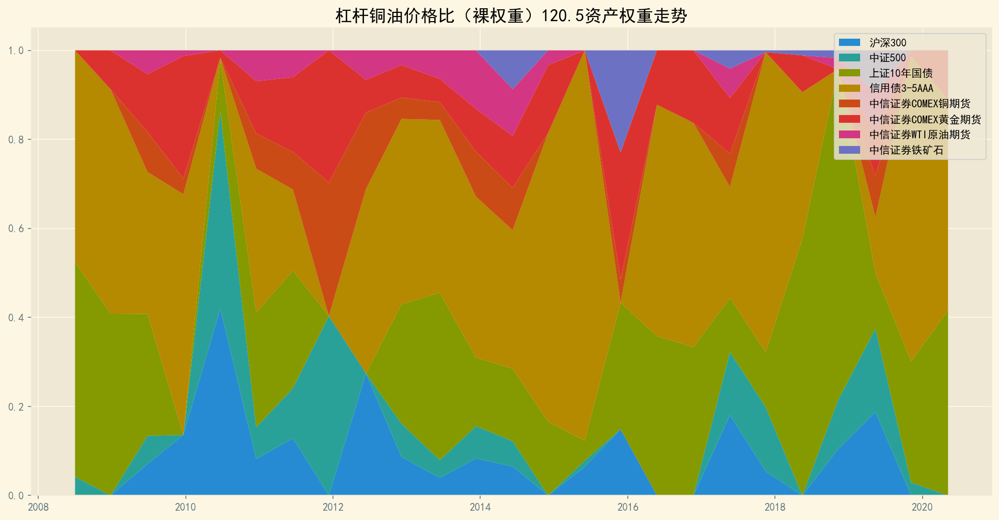

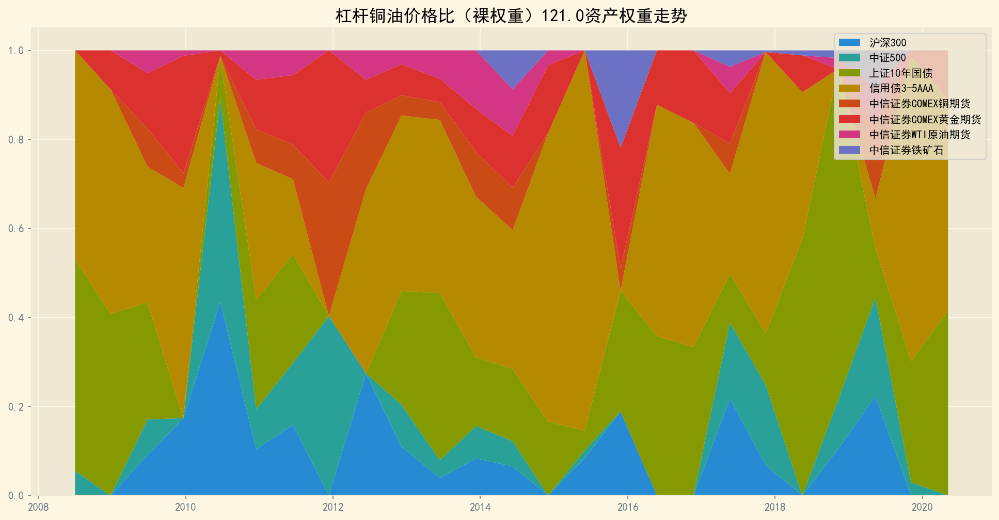

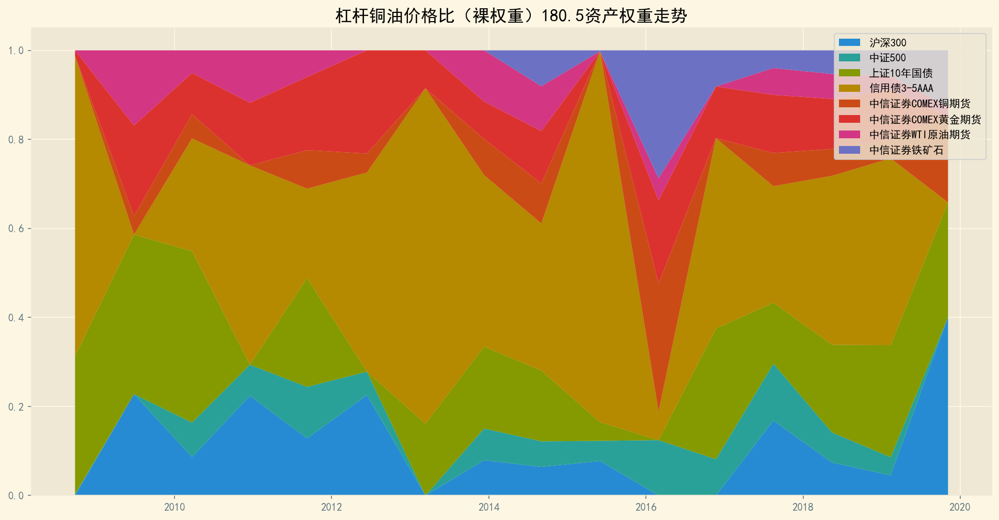

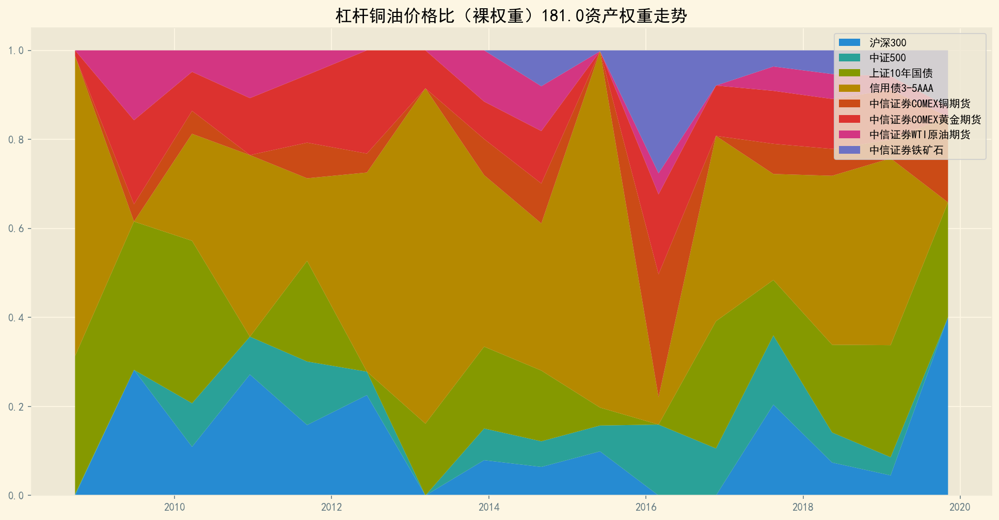

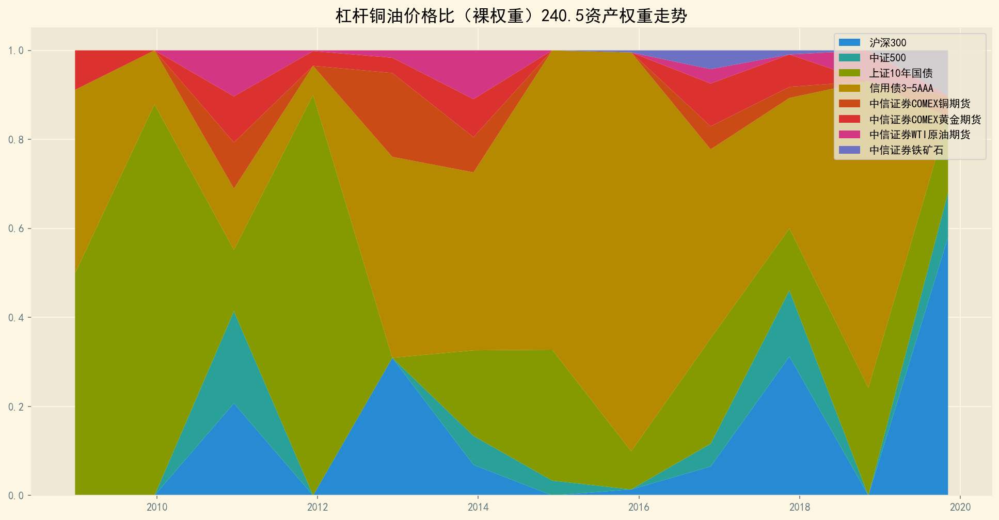

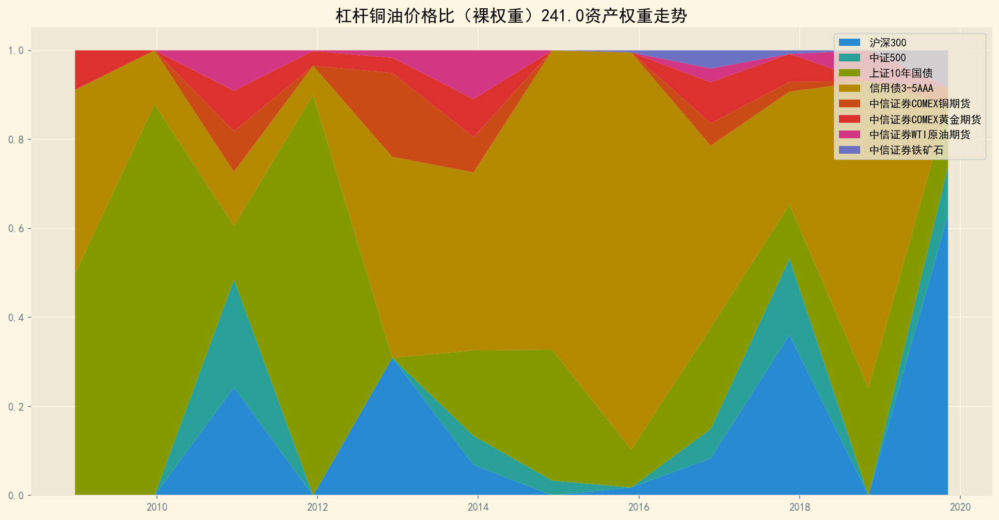

In [26]:
thrds = {'Equity':0.50, 'FixedIncome':0.90, 'Commodity':0.30}
factors = {'momentumX':False, 'momentumT':False, 
            'reverseX':False, 'reverseT':False,
            'turnover':False, 
            'copperGold':False, 'copperGas':True}

for t in timeWindow:
    for u in ups:
        tradeDF, weightDF = AlgoLoop.AlgoTrade(Assets, leverReturns, leverCumReturns, Turnovers, 
                                               mode='plain', dt=t, up=u, thresholds=thrds, 
                                               factorDict=factors)
        StatisticFunc.WeightPlot(tradeDF, weightDF, '杠杆铜油价格比（裸权重）'+str(t+u))

        leverNetValueDF_copperGas.loc[:, (t, u)] = tradeDF['投资组合净值'] / 10000  
        leverDailyPnlDF_copperGas.loc[:, (t, u)] = tradeDF['投资组合净值'] / tradeDF['投资组合净值'].shift(1) - 1.0
        leverDrawDownDF_copperGas.loc[:, (t, u)] = tradeDF['最大回撤']                      

### 回测表现汇总

In [27]:
# 汇总
leverSummaryDF_copperGas = pd.DataFrame(index=multiIDX)

leverSummaryDF_copperGas["年平均收益率"] = leverDailyPnlDF_copperGas.mean(axis=0).values * 250
leverSummaryDF_copperGas["年平均标准差"] = leverDailyPnlDF_copperGas.std(axis=0).values * np.sqrt(250)
leverSummaryDF_copperGas["无基准夏普比率"] = leverSummaryDF_copperGas["年平均收益率"] / leverSummaryDF_copperGas["年平均标准差"]
leverSummaryDF_copperGas["最大回撤"] = leverDrawDownDF_copperGas.min(axis=0).values

leverSummaryDF_copperGas

年平均收益率    年平均标准差   无基准夏普比率      最大回撤
交易周期 上调幅度                                        
20   0.5   0.052667  0.106707  0.493565 -0.336082
     1.0   0.052541  0.108303  0.485126 -0.327789
60   0.5   0.031741  0.116431  0.272612 -0.466683
     1.0   0.030845  0.120210  0.256596 -0.466683
120  0.5   0.105800  0.092877  1.139142 -0.208087
     1.0   0.102897  0.094893  1.084338 -0.204266
180  0.5   0.095304  0.088857  1.072559 -0.146184
     1.0   0.091202  0.090632  1.006279 -0.148073
240  0.5   0.046514  0.080199  0.579982 -0.226435
     1.0   0.041847  0.083612  0.500485 -0.237154

### 各投资组合净值曲线

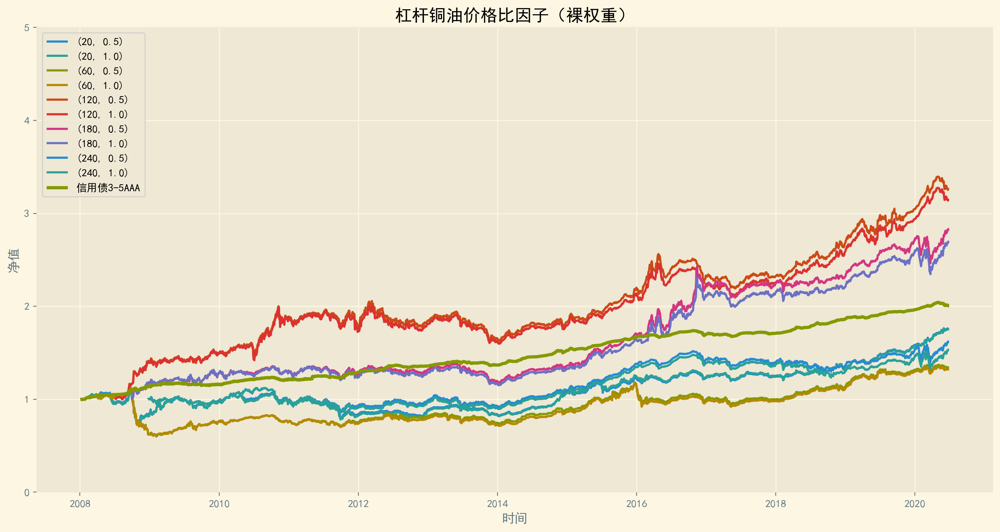

In [28]:
fig = plt.figure(figsize=(16, 8), dpi=200)

for col in leverNetValueDF_copperGas.columns:
    plt.plot(leverNetValueDF_copperGas.index, leverNetValueDF_copperGas[col], label=col)
    
plt.plot(cumReturns.index, cumReturns['信用债3-5AAA'], lw=3.0, label='信用债3-5AAA')

plt.xlabel('时间')
plt.ylabel('净值')
plt.ylim(0.0, 5.0)
plt.legend(loc='upper left')
plt.title('杠杆铜油价格比因子（裸权重）')
plt.show()